In [1]:
import os
import sys
import glob
import imageio
import numpy as np
import scipy.io as sio
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import matplotlib.gridspec as gridspec

In [2]:
plt.rcParams['figure.figsize'] = [4.0, 4.0]
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

plt.rcParams['font.size'] = 12
plt.rcParams['legend.fontsize'] = 'small'
plt.rcParams['lines.linewidth'] = 1

In [3]:
class resonance_lines(object):
	
	def __init__(self, Qx_range, Qy_range, orders, periodicity):
		
		if np.std(Qx_range):
			self.Qx_min = np.min(Qx_range)
			self.Qx_max = np.max(Qx_range)
		else:
			self.Qx_min = np.floor(Qx_range)-0.05
			self.Qx_max = np.floor(Qx_range)+1.05
		if np.std(Qy_range):
			self.Qy_min = np.min(Qy_range)
			self.Qy_max = np.max(Qy_range)
		else:
			self.Qy_min = np.floor(Qy_range)-0.05
			self.Qy_max = np.floor(Qy_range)+1.05

		self.periodicity = periodicity
									
		nx, ny = [], []

		for order in np.nditer(np.array(orders)):
			t = np.array(range(-order, order+1))
			nx.extend(order - np.abs(t))
			ny.extend(t)
		nx = np.array(nx)
		ny = np.array(ny)
	
		cextr = np.array([nx*np.floor(self.Qx_min)+ny*np.floor(self.Qy_min), \
						  nx*np.ceil(self.Qx_max)+ny*np.floor(self.Qy_min), \
						  nx*np.floor(self.Qx_min)+ny*np.ceil(self.Qy_max), \
						  nx*np.ceil(self.Qx_max)+ny*np.ceil(self.Qy_max)], dtype='int')
		cmin = np.min(cextr, axis=0)
		cmax = np.max(cextr, axis=0)
		res_sum = [range(cmin[i], cmax[i]+1) for i in xrange(cextr.shape[1])]								
		self.resonance_list = zip(nx, ny, res_sum)
		
	def plot_resonance(self, figure_object = None):	
		plt.ion()
		if figure_object:
			fig = figure_object
			plt.figure(fig.number)
		else:
			fig = plt.figure()
		Qx_min = self.Qx_min
		Qx_max = self.Qx_max
		Qy_min = self.Qy_min
		Qy_max = self.Qy_max 
		plt.xlim(Qx_min, Qx_max)
		plt.ylim(Qy_min, Qy_max)
		plt.xlabel('Qx')
		plt.ylabel('Qy')
		for resonance in self.resonance_list:
			nx = resonance[0]
			ny = resonance[1]
			for res_sum in resonance[2]:
				if ny:
					line, = plt.plot([Qx_min, Qx_max], \
					    [(res_sum-nx*Qx_min)/ny, (res_sum-nx*Qx_max)/ny])
				else:
					line, = plt.plot([np.float(res_sum)/nx, np.float(res_sum)/nx],[Qy_min, Qy_max])
				if ny%2:
					plt.setp(line, linestyle='--') # for skew resonances
				if res_sum%self.periodicity:
					plt.setp(line, color='b')	# non-systematic resonances
				else:
					plt.setp(line, color='r', linewidth=2.0) # systematic resonances
		plt.draw()
		return fig
		
	def print_resonances(self):
		for resonance in self.resonance_list:
			for res_sum in resonance[2]:
				'''
				print str(resonance[0]).rjust(3), 'Qx ', ("+", "-")[resonance[1]<0], \
					  str(abs(resonance[1])).rjust(2), 'Qy = ', str(res_sum).rjust(3), \
					  '\t', ("(non-systematic)", "(systematic)")[res_sum%self.periodicity==0]
				'''
				print '%s %s%s = %s\t%s'%(str(resonance[0]).rjust(2), ("+", "-")[resonance[1]<0], \
						str(abs(resonance[1])).rjust(2), str(res_sum).rjust(4), \
						("(non-systematic)", "(systematic)")[res_sum%self.periodicity==0])


In [4]:
def add_input_file(dd, filename, label):
	f = filename
	p = dict()
	sio.loadmat(f, mdict=p)
	dd[label] = p
	print '\tAdded output data from ', filename, '\t dictionary key: ', label
	return dd

In [5]:
# Load a file
dd = dict()
maxi = 50
#turns = np.linspace(1, maxi, maxi)
turns = range(1,maxi)
print turns

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]


In [6]:
plt.close('all')
source_dir =  './bunch_output/'

filename = 'mainbunch'
files = glob.glob(source_dir + filename + '*.mat')
files.sort()

# Remove bunch before tracking - no tunespread
for i, file in enumerate(files):
    if 'mainbunch_-000001.mat' in file:
        files.remove(file)
files = files[:50]
files

['./bunch_output/mainbunch_000001.mat',
 './bunch_output/mainbunch_000002.mat',
 './bunch_output/mainbunch_000003.mat',
 './bunch_output/mainbunch_000004.mat',
 './bunch_output/mainbunch_000005.mat',
 './bunch_output/mainbunch_000006.mat',
 './bunch_output/mainbunch_000007.mat',
 './bunch_output/mainbunch_000008.mat',
 './bunch_output/mainbunch_000009.mat',
 './bunch_output/mainbunch_000010.mat',
 './bunch_output/mainbunch_000011.mat',
 './bunch_output/mainbunch_000012.mat',
 './bunch_output/mainbunch_000013.mat',
 './bunch_output/mainbunch_000014.mat',
 './bunch_output/mainbunch_000015.mat',
 './bunch_output/mainbunch_000016.mat',
 './bunch_output/mainbunch_000017.mat',
 './bunch_output/mainbunch_000018.mat',
 './bunch_output/mainbunch_000019.mat',
 './bunch_output/mainbunch_000020.mat',
 './bunch_output/mainbunch_000021.mat',
 './bunch_output/mainbunch_000022.mat',
 './bunch_output/mainbunch_000023.mat',
 './bunch_output/mainbunch_000024.mat',
 './bunch_output/mainbunch_000025.mat',


In [7]:
main_label = 'PFW 15% Beta-Beating V_10'
sc = 'SbS'
legend_label = 'Turn'

# Simple Tune Footprint

In [8]:
print_simple = 0
if print_simple:
    for i, file in enumerate(files):
        folder = file.split('/')[0] + '/' + file.split('/')[1]
        case = 'V'
        tune_tit = '6.10'
        tune_sav = '6p10' 

        try: 
            turn = int(file.split('mainbunch_')[-1][:-4])
            turn = '%04d'%turn
        except:
            turn = ''

        print '\t Plotting ', case, ' scan tune =', tune_tit, ' turn = ', turn

        particles = sio.loadmat(file, squeeze_me=True,  struct_as_record=False)['particles']
        x  = particles.x
        xp = particles.xp
        y  = particles.y
        yp = particles.yp
        z  = particles.z
        dE = particles.dE

        fontsize=15

        qx = particles.ParticlePhaseAttributes[2,:]
        qy = particles.ParticlePhaseAttributes[3,:]
        qx[np.where(qx>0.5)] -= 1
        qy[np.where((qy>0.6) & (qx<0.25))] -= 1

        resonances = resonance_lines((5.75, 6.25),(5.75, 6.25),(1,2,3,4),10)
        fontsize=17

        f, ax = plt.subplots(1,figsize=(6,6))

        my_cmap = plt.cm.jet
        my_cmap.set_under('w',1)

        r = resonances

        ax.hist2d(6+qx, 6+qy, bins=1000, cmap=my_cmap, vmin=1, range=[[r.Qx_min, r.Qx_max], [r.Qy_min, r.Qy_max]]) #, norm=mcolors.PowerNorm(gamma))

        resonances.plot_resonance(f)

        ax.xaxis.label.set_size(fontsize)
        ax.yaxis.label.set_size(fontsize)

        ax.tick_params(labelsize=fontsize)

        title = str( main_label + ' ' + tune_tit + ' turn ' + turn  )    
        plt.title(title, fontsize=fontsize)
        plt.tight_layout()
        savename = str(folder + '/Tune_Footprint_' + case + '_' + tune_sav + '_turn_' + turn + '.png' )
        f.savefig(savename, dpi=500)
        #plt.close(f)

# Add x and y histograms

In [9]:
 gifnames =[]

for i, file in enumerate(files):
    
    folder = file.split('/')[0] + '/' + file.split('/')[1]
    case = 'V'
    tune_tit = '6.10'
    tune_sav = '6p10' 
    
    try: 
        turn = int(file.split('mainbunch_')[-1][:-4])
        #turn = '%04d'%turn
    except:
        turn = ''
        
    print '\t Plotting ', case, ' scan tune =', tune_tit, ' turn = ', turn, ' with histograms'
        
    particles = sio.loadmat(file, squeeze_me=True,  struct_as_record=False)['particles']
    x  = particles.x
    xp = particles.xp
    y  = particles.y
    yp = particles.yp
    z  = particles.z
    dE = particles.dE

    fontsize=15

    qx = particles.ParticlePhaseAttributes[2,:]
    qy = particles.ParticlePhaseAttributes[3,:]
    qx[np.where(qx>0.5)] -= 1
    qy[np.where((qy>0.6) & (qx<0.25))] -= 1

    resonances = resonance_lines((5.75, 6.25),(5.75, 6.25),(1,2,3,4),10)
    fontsize=17
    
    f, ax = plt.subplots(1, figsize=(6,6))
    gridspec.GridSpec(3,3)
    #f.subplots_adjust(hspace = 0)	# Horizontal spacing between subplots
    f.subplots_adjust(wspace = 0)	# Vertical spacing between subplots
    
    
    my_cmap = plt.cm.jet
    my_cmap.set_under('w',1)
    
    r = resonances
    
    title = str( main_label + ' ' + tune_tit + ' turn ' + str(turn)  )    
    
    # First subplot
    plt.subplot2grid((3,3), (0,0), colspan=2, rowspan=1)   
    plt.hist(6+qx, bins=1000, range=(r.Qx_min, r.Qx_max)) #, norm=mcolors.PowerNorm(gamma))
    plt.ylabel('Frequency')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.title(title, fontsize=fontsize)
    
    # Main plot
    plt.subplot2grid((3,3), (1,0), colspan=2, rowspan=2)
    plt.hist2d(6+qx, 6+qy, bins=1000, cmap=my_cmap, vmin=1, range=[[r.Qx_min, r.Qx_max], [r.Qy_min, r.Qy_max]]) #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel(r'Q$_x$')
    plt.ylabel(r'Q$_y$')
    resonances.plot_resonance(f)
    
    # Second subplot
    plt.subplot2grid((3,3), (1,2), colspan=1, rowspan=2)    
    plt.hist(6+qy, bins=1000, range=(r.Qy_min, r.Qy_max), orientation=u'horizontal') #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('Frequency')
    plt.grid(which='both', ls=':', lw=0.5)
    
    current_axis = plt.gca()
    #current_axis.axes.get_yaxis().set_visible(False)
    
    ax.xaxis.label.set_size(fontsize)
    ax.yaxis.label.set_size(fontsize)
    
    ax.tick_params(labelsize=fontsize)
    
    plt.tight_layout()
    savename = str(folder + '/Tune_Footprint_' + case + '_' + tune_sav + '_turn_' + str(turn) + '.png' )
    gifnames.append(savename)
    f.savefig(savename, dpi=500)
    plt.close(f)

	 Plotting  V  scan tune = 6.10  turn =  1  with histograms
	 Plotting  V  scan tune = 6.10  turn =  2  with histograms
	 Plotting  V  scan tune = 6.10  turn =  3  with histograms
	 Plotting  V  scan tune = 6.10  turn =  4  with histograms
	 Plotting  V  scan tune = 6.10  turn =  5  with histograms
	 Plotting  V  scan tune = 6.10  turn =  6  with histograms
	 Plotting  V  scan tune = 6.10  turn =  7  with histograms
	 Plotting  V  scan tune = 6.10  turn =  8  with histograms
	 Plotting  V  scan tune = 6.10  turn =  9  with histograms
	 Plotting  V  scan tune = 6.10  turn =  10  with histograms
	 Plotting  V  scan tune = 6.10  turn =  11  with histograms
	 Plotting  V  scan tune = 6.10  turn =  12  with histograms
	 Plotting  V  scan tune = 6.10  turn =  13  with histograms
	 Plotting  V  scan tune = 6.10  turn =  14  with histograms
	 Plotting  V  scan tune = 6.10  turn =  15  with histograms
	 Plotting  V  scan tune = 6.10  turn =  16  with histograms
	 Plotting  V  scan tune = 6.10  

# XY Real Space

In [10]:
xy_gifnames =[]
fontsize=12

for i, file in enumerate(files):
    bin_size = 256
    
    folder = file.split('/')[0] + '/' + file.split('/')[1]
    case = 'V'
    tune_tit = '6.10'
    tune_sav = '6p10' 
    
    try: 
        turn = int(file.split('mainbunch_')[-1][:-4])
        #turn = '%04d'%turn
    except:
        turn = ''
        
    print '\t Plotting ', main_label, ' scan tune =', tune_tit, ' turn = ', str(turn), '  real space with histograms'
        
    particles = sio.loadmat(file, squeeze_me=True,  struct_as_record=False)['particles']
    x  = particles.x * 1E3
    xp = particles.xp* 1E3
    y  = particles.y * 1E3
    yp = particles.yp* 1E3
    z  = particles.z * 1E9
    dE = particles.dE
    
    f, ax = plt.subplots(1, figsize=(6,6))
    gridspec.GridSpec(3,3)
    f.subplots_adjust(hspace = 0)	# Horizontal spacing between subplots
    f.subplots_adjust(wspace = 0)	# Vertical spacing between subplots
    
    
    my_cmap = plt.cm.jet
    my_cmap.set_under('w',1)
        
    title = str( main_label + ' ' + tune_tit + ' turn ' + str(turn)  )    
    
    # First subplot
    plt.subplot2grid((3,3), (0,0), colspan=2, rowspan=1)   
    plt.hist(x, bins=bin_size, range=(np.min(x), np.max(x))) #, norm=mcolors.PowerNorm(gamma))
    plt.ylabel('Frequency')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.title(title, fontsize=fontsize)
    plt.xlim(-20, 20)
    
    # Main plot
    plt.subplot2grid((3,3), (1,0), colspan=2, rowspan=2)
    plt.hist2d(x, y, bins=bin_size, cmap=my_cmap, vmin=1, range=[[np.min(x), np.max(x)], [np.min(y), np.max(y)]]) #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('x [mm]')
    plt.ylabel('y [mm]')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.xlim(-20, 20)
    plt.ylim(-20, 20)
    
    # Second subplot
    plt.subplot2grid((3,3), (1,2), colspan=1, rowspan=2)    
    plt.hist(y, bins=bin_size, range=(np.min(y), np.max(y)), orientation=u'horizontal') #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('Test')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.ylim(-20, 20)
    
    #current_axis.axes.get_yaxis().set_visible(False)
    
    current_axis = plt.gca()
    
    #ax.xaxis.label.set_size(fontsize)
    #ax.yaxis.label.set_size(fontsize)
    
    #ax.tick_params(labelsize=fontsize)
    
    plt.tight_layout()
    savename = str(folder + '/Real_Space_' + case + '_' + tune_sav + '_turn_' + str(turn) + '.png' )
    xy_gifnames.append(savename)
    f.savefig(savename, dpi=500)
    plt.close(f)

	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  1   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  2   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  3   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  4   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  5   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  6   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  7   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  8   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  9   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  scan tune = 6.10  turn =  10   real space with histograms
	 Plotting  PFW 15% Beta-Beating V_10  

# x xp phase space

	 Plotting  V  scan tune = 6.10  turn =  1   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  2   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  3   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  4   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  5   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  6   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  7   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  8   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  9   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  10   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  11   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  12   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  13   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  14   real space wit

/usr/lib64/python2.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


	 Plotting  V  scan tune = 6.10  turn =  22   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  23   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  24   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  25   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  26   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  27   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  28   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  29   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  30   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  31   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  32   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  33   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  34   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  35   real 

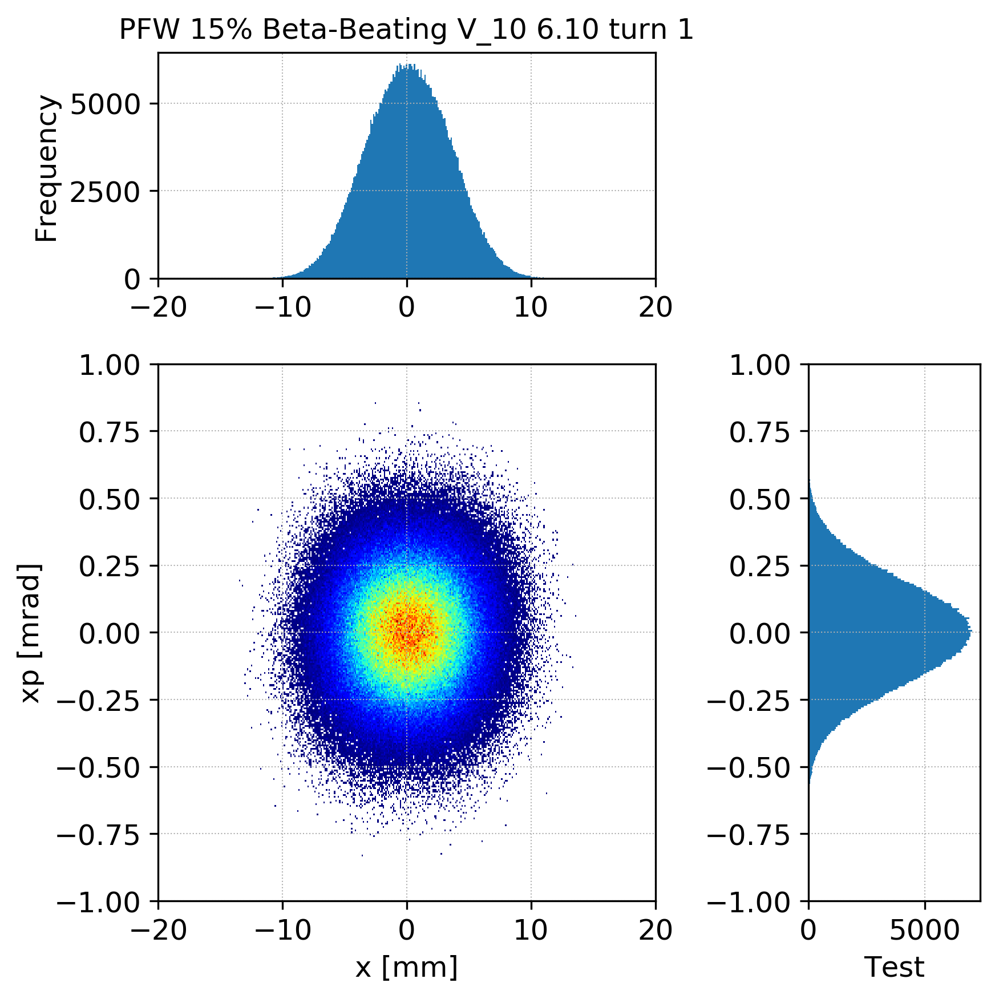

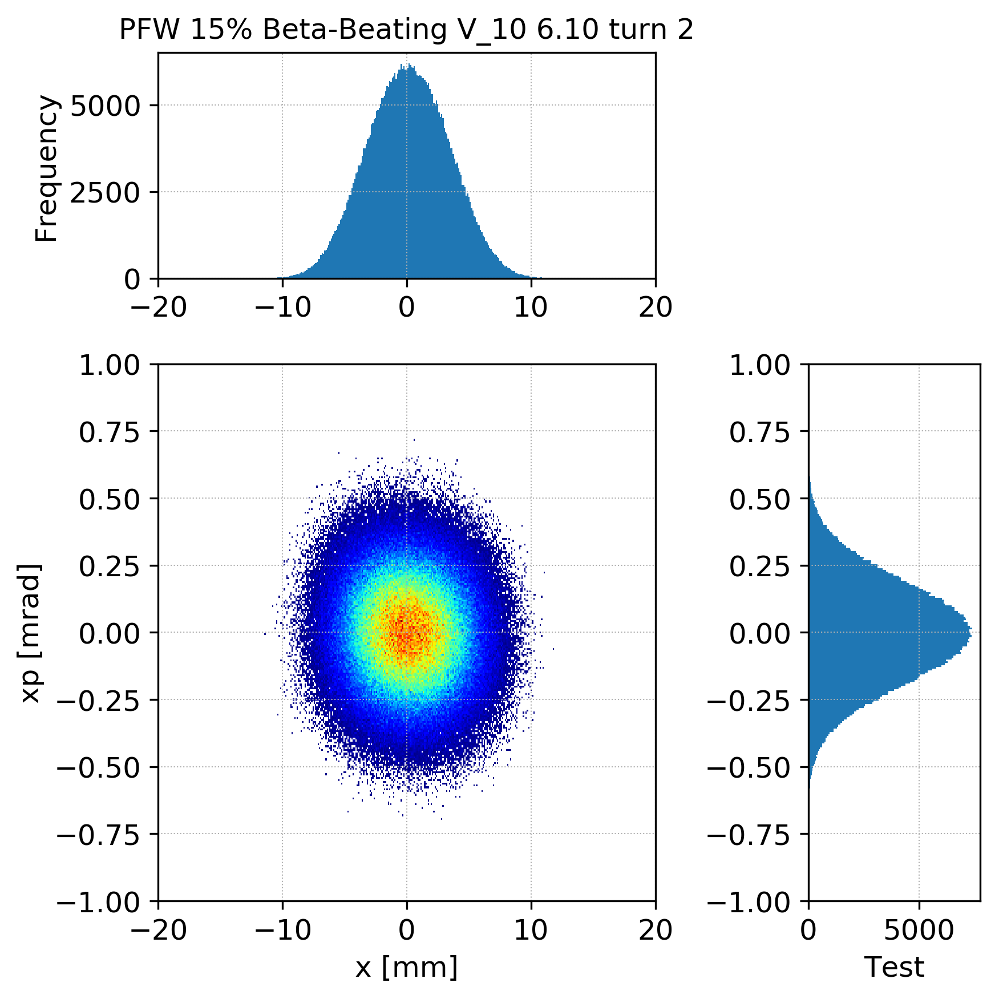

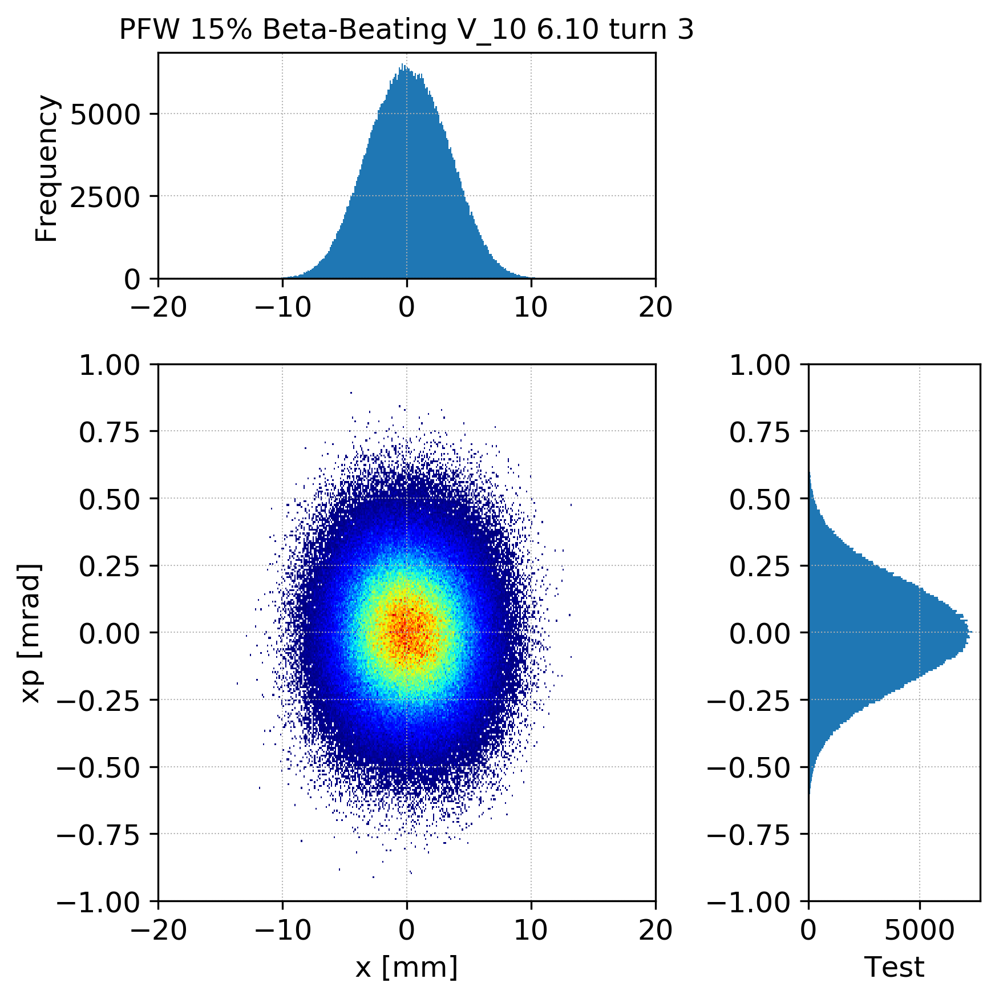

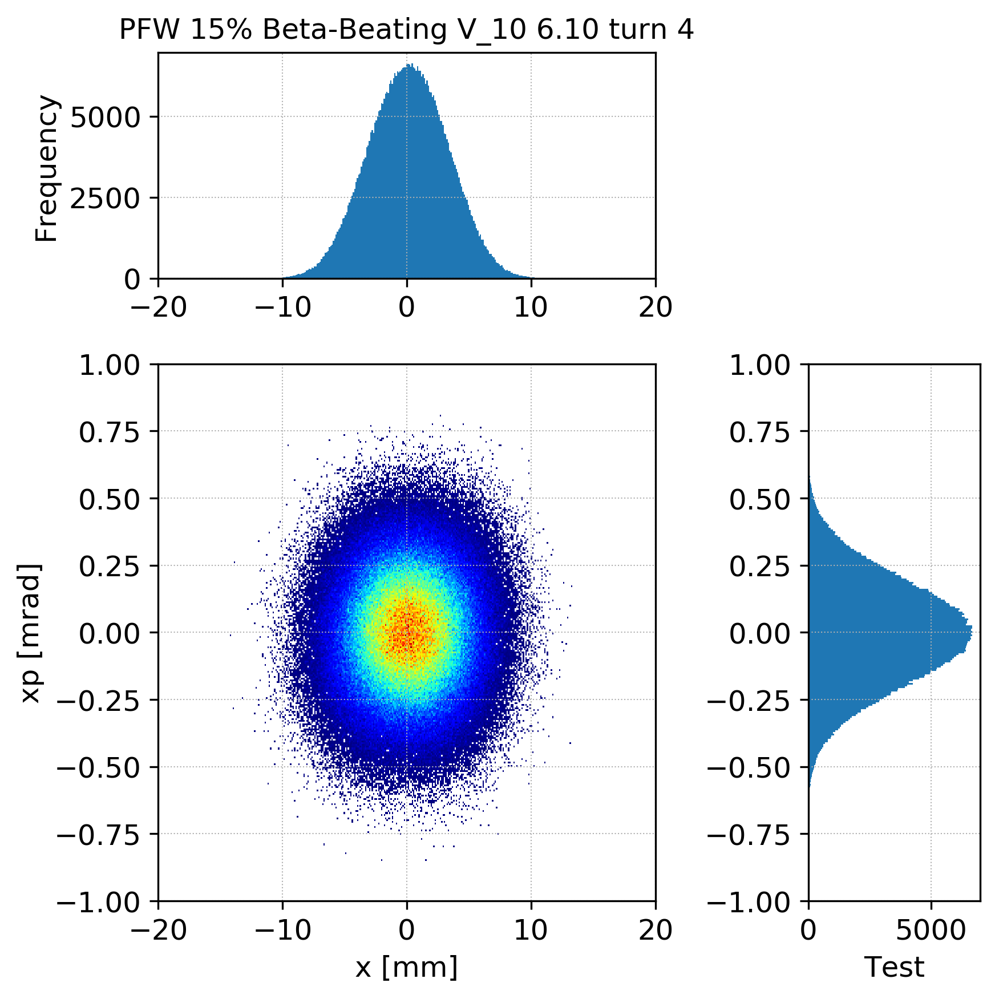

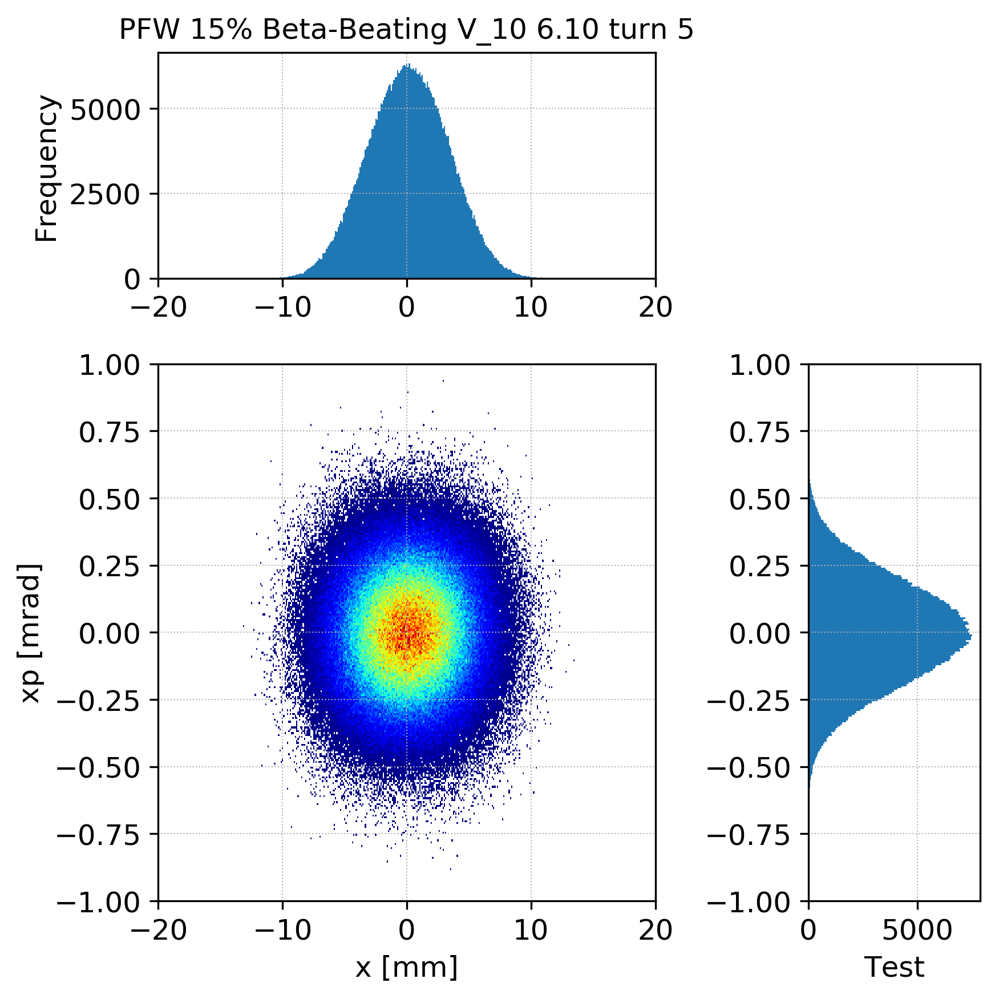

...

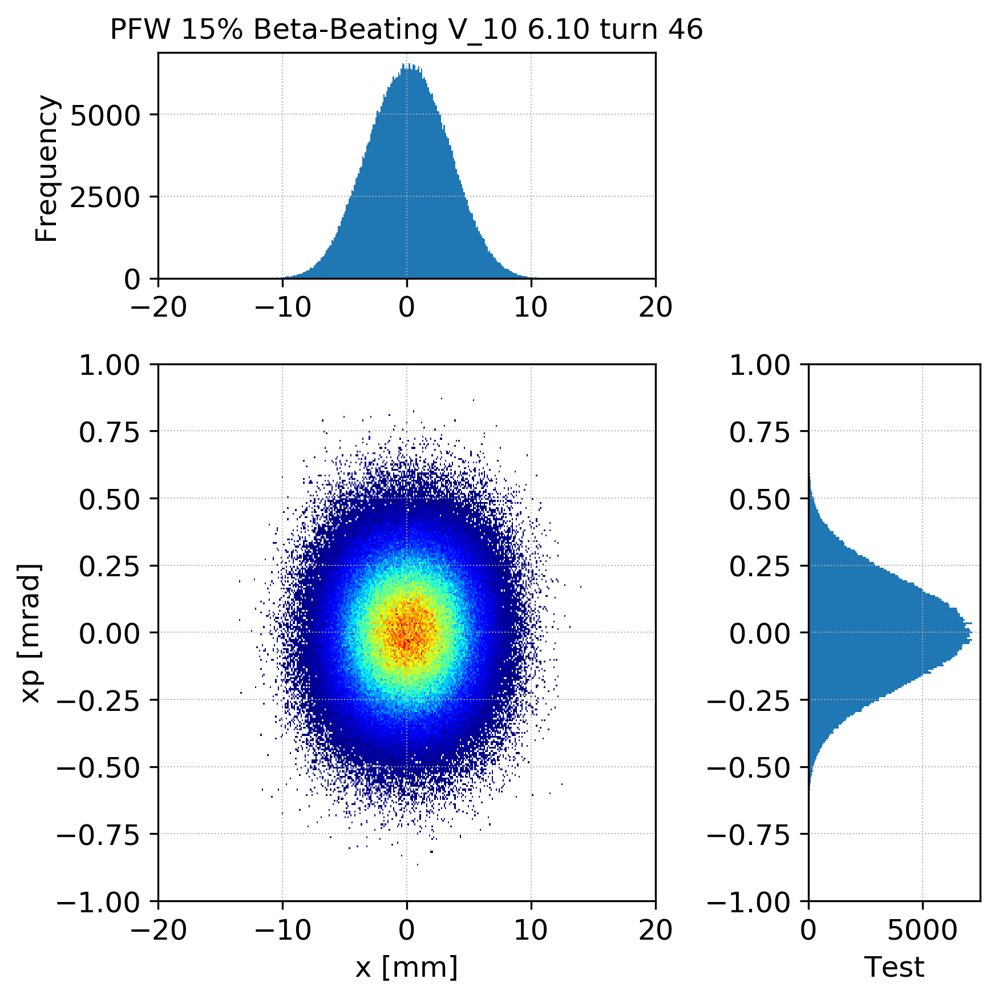

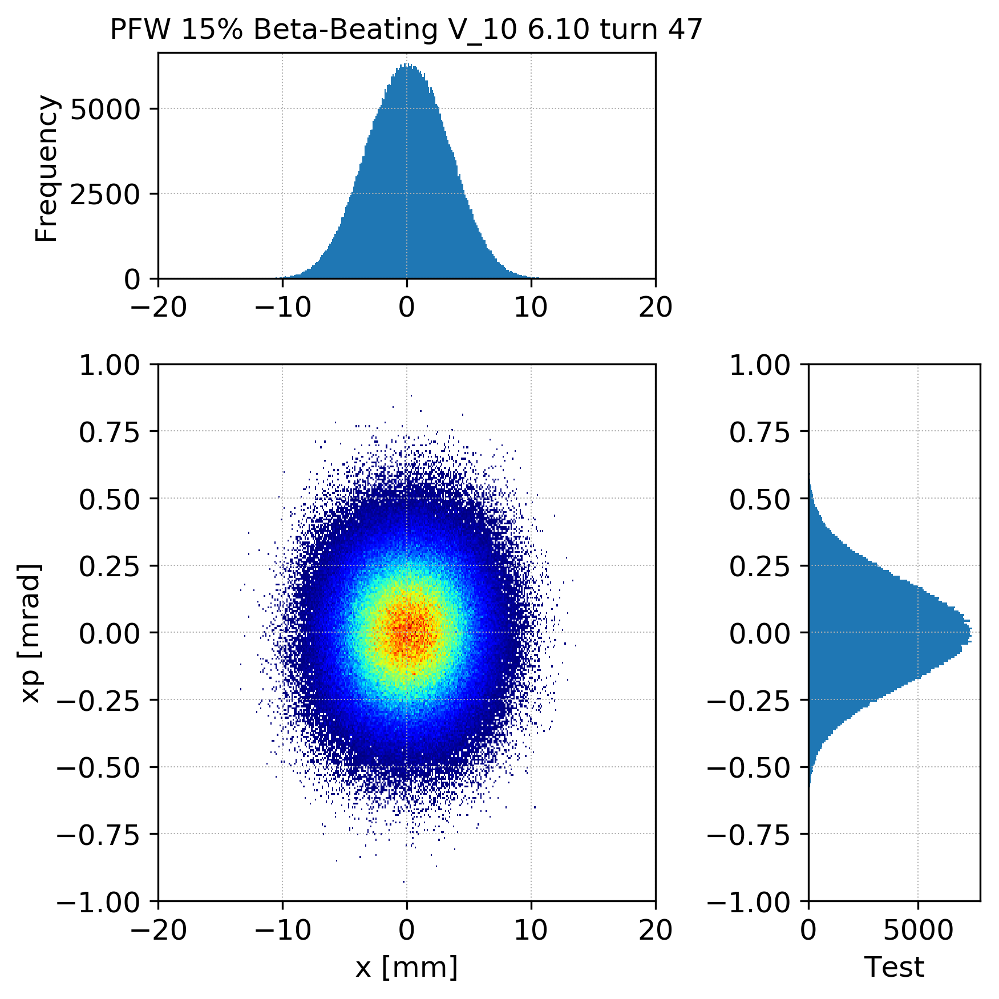

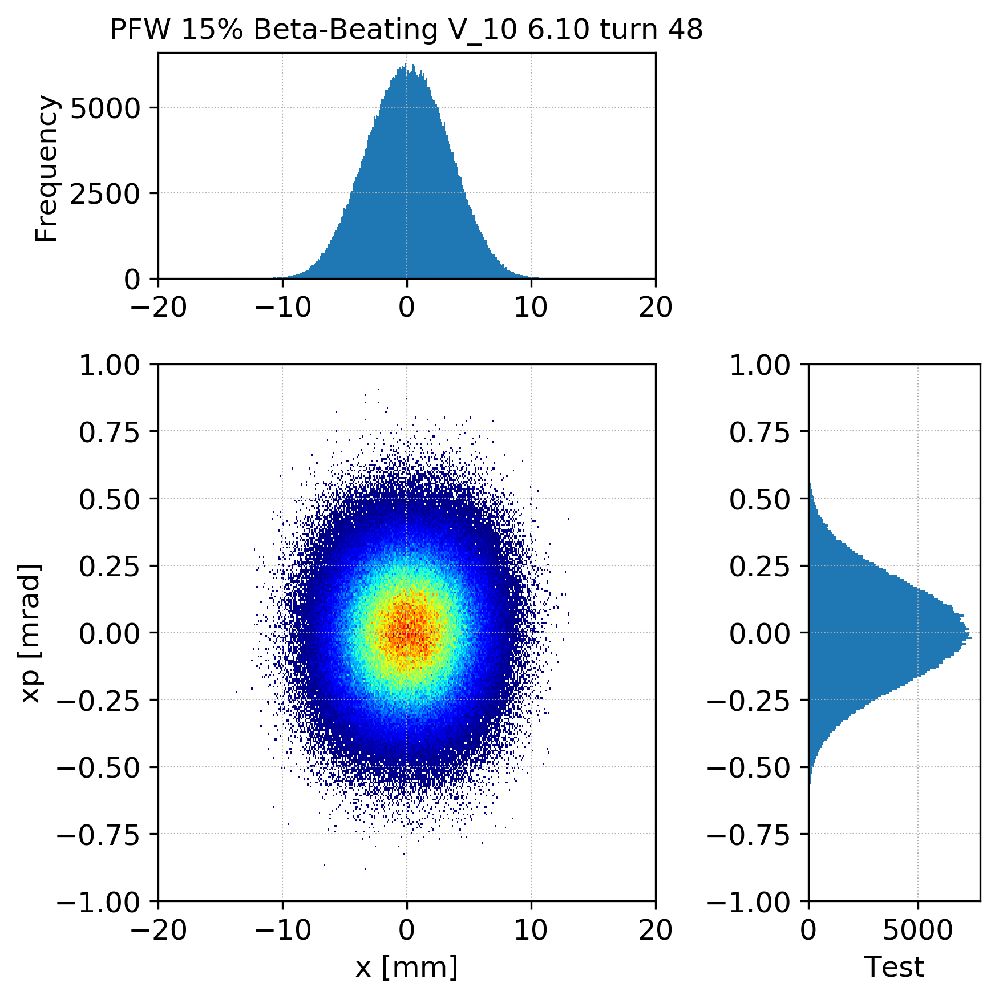

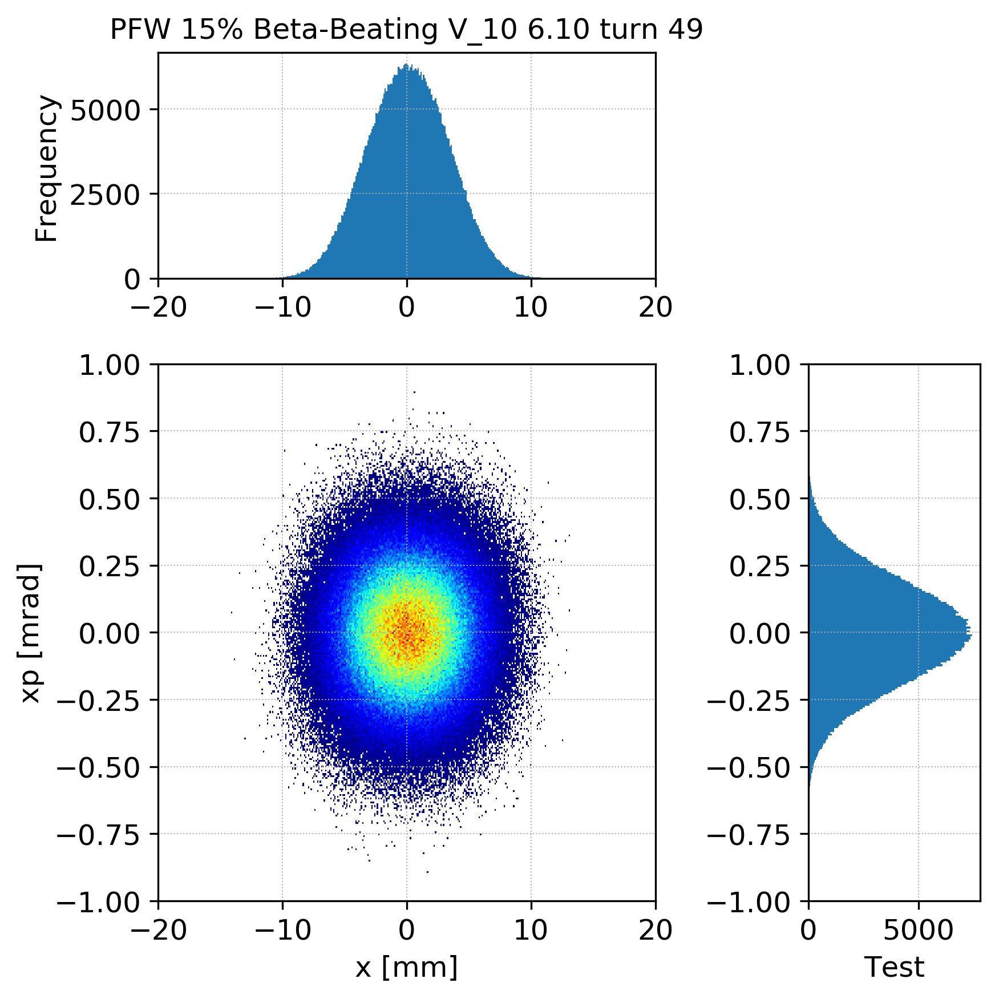

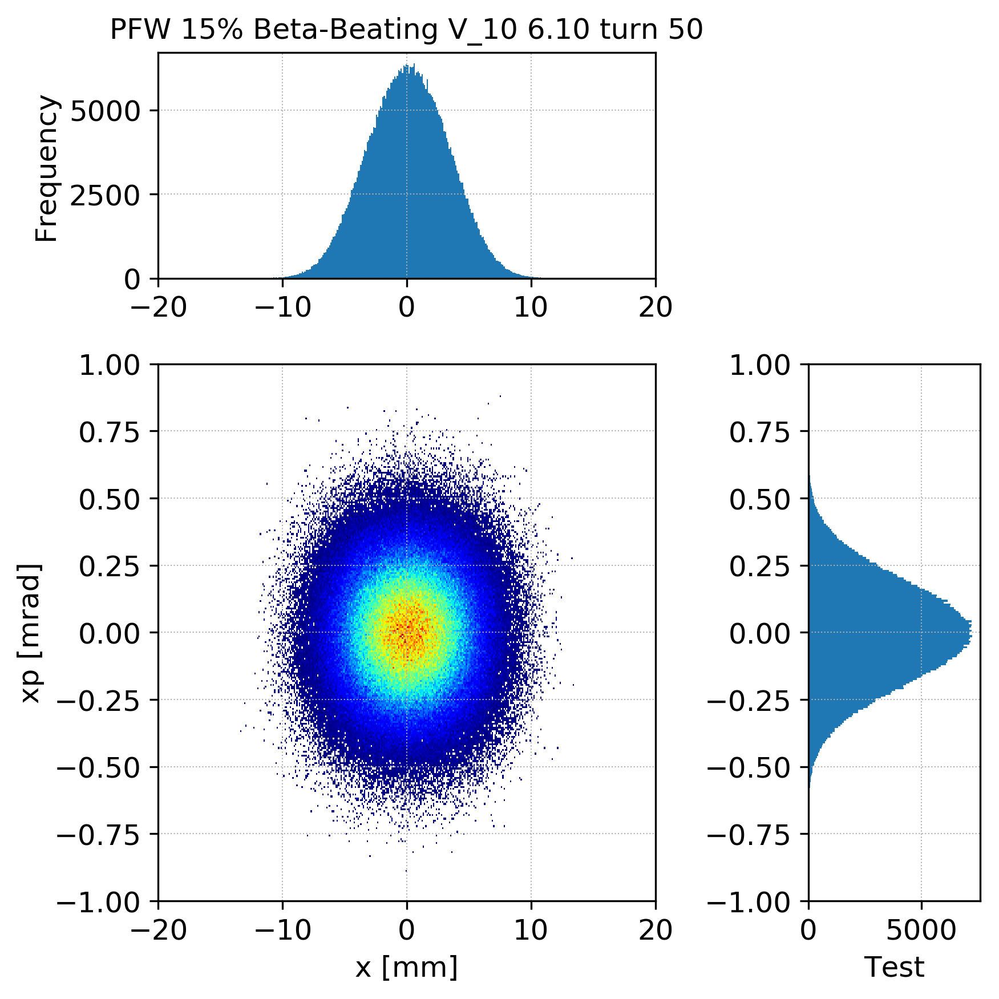

In [11]:
xxp_gifnames =[]

for i, file in enumerate(files):
    bin_size = 256
    
    folder = file.split('/')[0] + '/' + file.split('/')[1]
    case = 'V'
    tune_tit = '6.10'
    tune_sav = '6p10'  
    
    try: 
        turn = int(file.split('mainbunch_')[-1][:-4])
        #turn = '%04d'%turn
    except:
        turn = ''
        
    print '\t Plotting ', case, ' scan tune =', tune_tit, ' turn = ', str(turn), '  real space with histograms'
        
    particles = sio.loadmat(file, squeeze_me=True,  struct_as_record=False)['particles']
    x  = particles.x * 1E3
    xp = particles.xp* 1E3
    y  = particles.y * 1E3
    yp = particles.yp* 1E3
    z  = particles.z * 1E9
    dE = particles.dE
    
    f, ax = plt.subplots(1, figsize=(6,6))
    gridspec.GridSpec(3,3)
    #f.subplots_adjust(hspace = 0)	# Horizontal spacing between subplots
    f.subplots_adjust(wspace = 0)	# Vertical spacing between subplots
    
    
    my_cmap = plt.cm.jet
    my_cmap.set_under('w',1)
        
    title = str( main_label + ' ' + tune_tit + ' turn ' + str(turn)  ) 
    
    # First subplot
 
    plt.subplot2grid((3,3), (0,0), colspan=2, rowspan=1)   
    plt.hist(x, bins=bin_size, range=(np.min(x), np.max(x))) #, norm=mcolors.PowerNorm(gamma))
    plt.title(title, fontsize=fontsize)
    plt.ylabel('Frequency')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.xlim(-20, 20)   
    
    # Main plot
    plt.subplot2grid((3,3), (1,0), colspan=2, rowspan=2)
    plt.hist2d(x, xp, bins=bin_size, cmap=my_cmap, vmin=1, range=[[np.min(x), np.max(x)], [np.min(xp), np.max(xp)]]) #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('x [mm]')
    plt.ylabel('xp [mrad]')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.xlim(-20, 20)
    plt.ylim(-1, 1)
    
    # Second subplot
    plt.subplot2grid((3,3), (1,2), colspan=1, rowspan=2)    
    plt.hist(xp, bins=bin_size, range=(np.min(xp), np.max(xp)), orientation=u'horizontal') #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('Test')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.ylim(-1, 1)
    
    current_axis = plt.gca()
    #current_axis.axes.get_yaxis().set_visible(False)
    
    #ax.xaxis.label.set_size(fontsize)
    #ax.yaxis.label.set_size(fontsize)
    
    #ax.tick_params(labelsize=fontsize)
    
    plt.tight_layout()
    savename = str(folder + '/X_Phase_Space_' + case + '_' + tune_sav + '_turn_' + str(turn) + '.png' )
    xxp_gifnames.append(savename)
    f.savefig(savename, dpi=500)
    #plt.close(f)

# y yp phase space

	 Plotting  V  scan tune = 6.10  turn =  1   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  2   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  3   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  4   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  5   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  6   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  7   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  8   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  9   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  10   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  11   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  12   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  13   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  14   real space wit

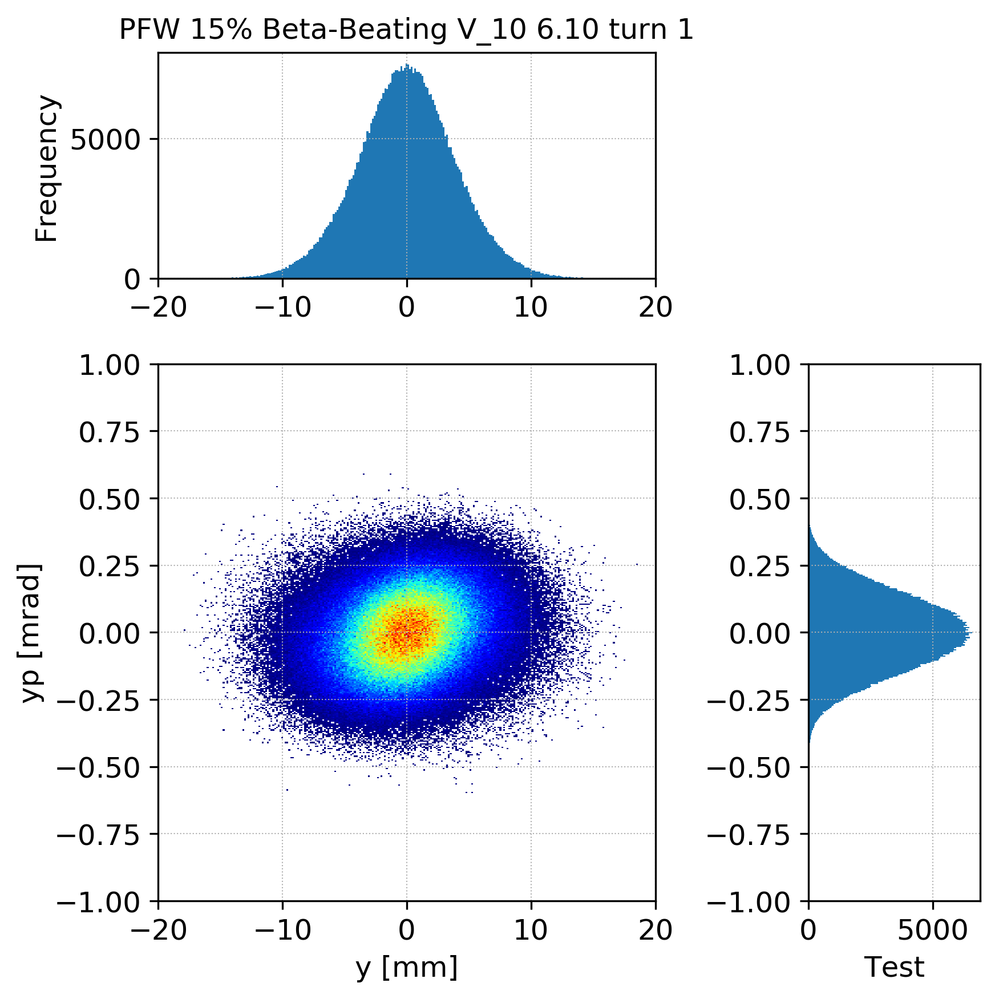

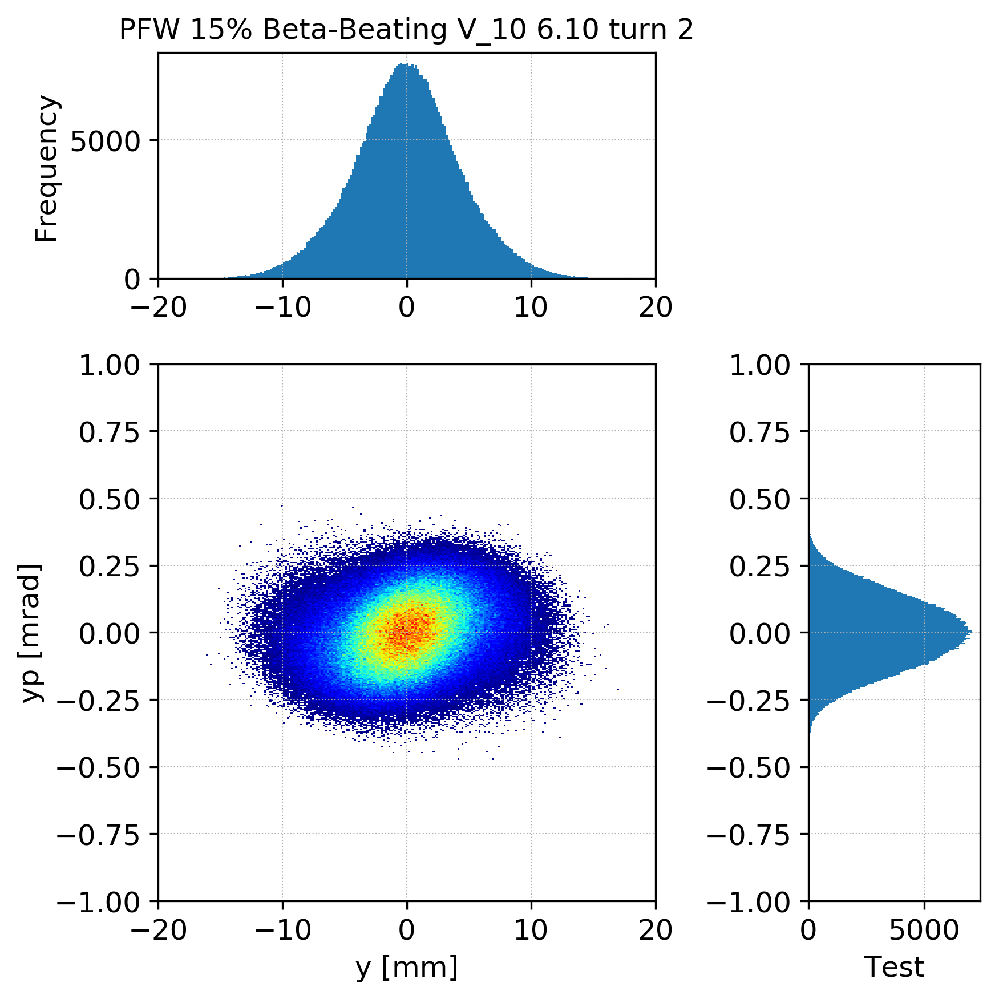

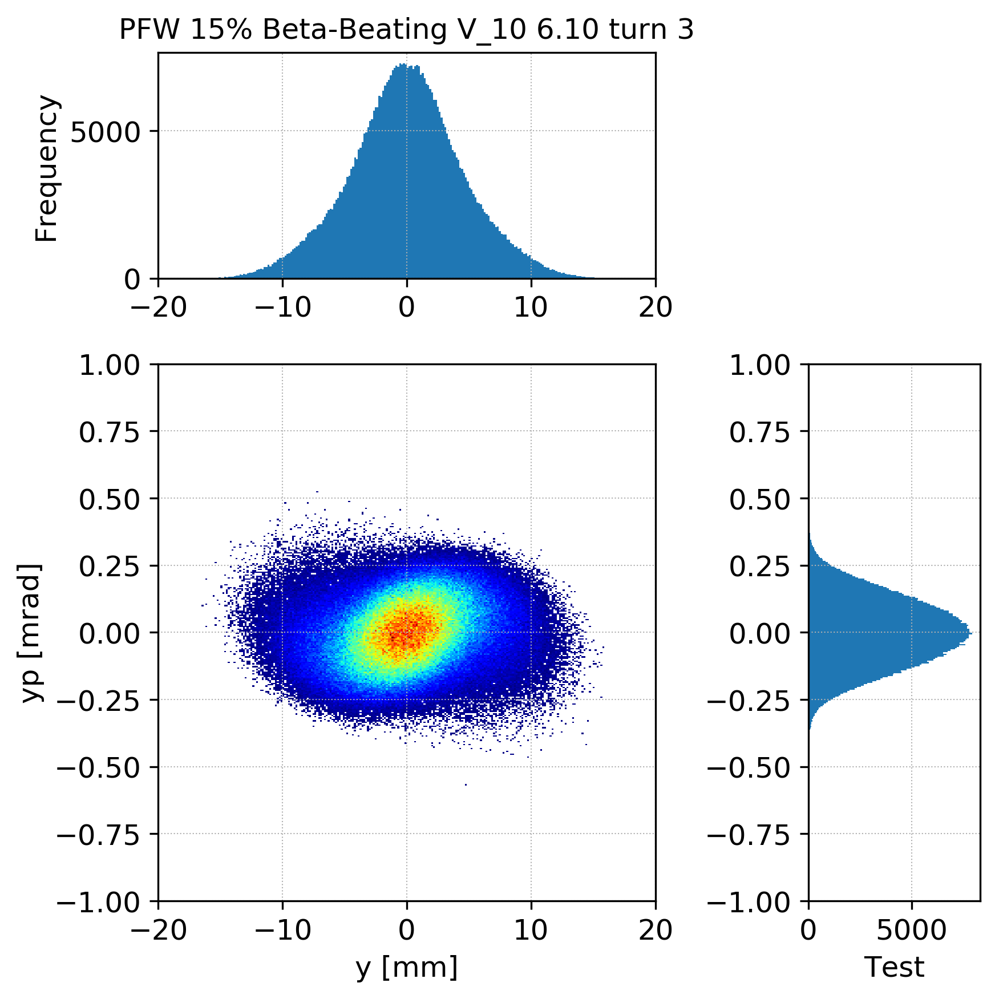

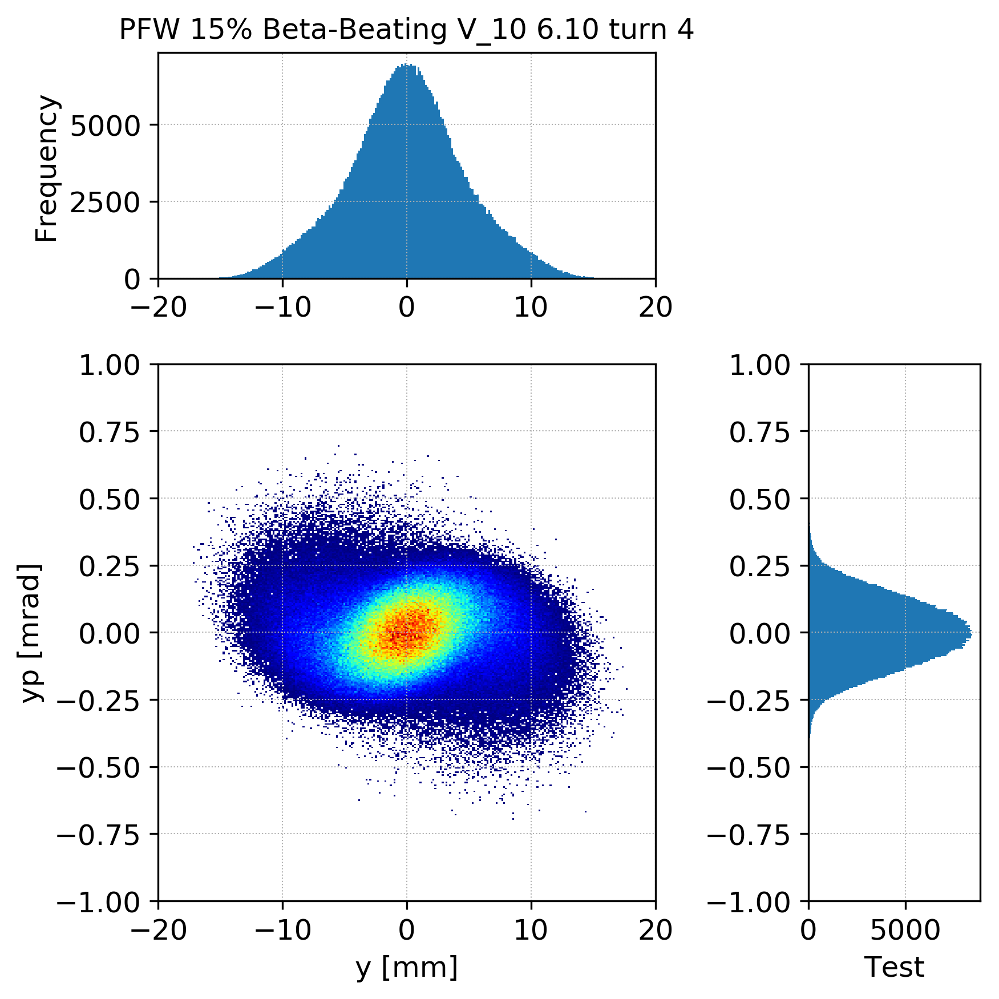

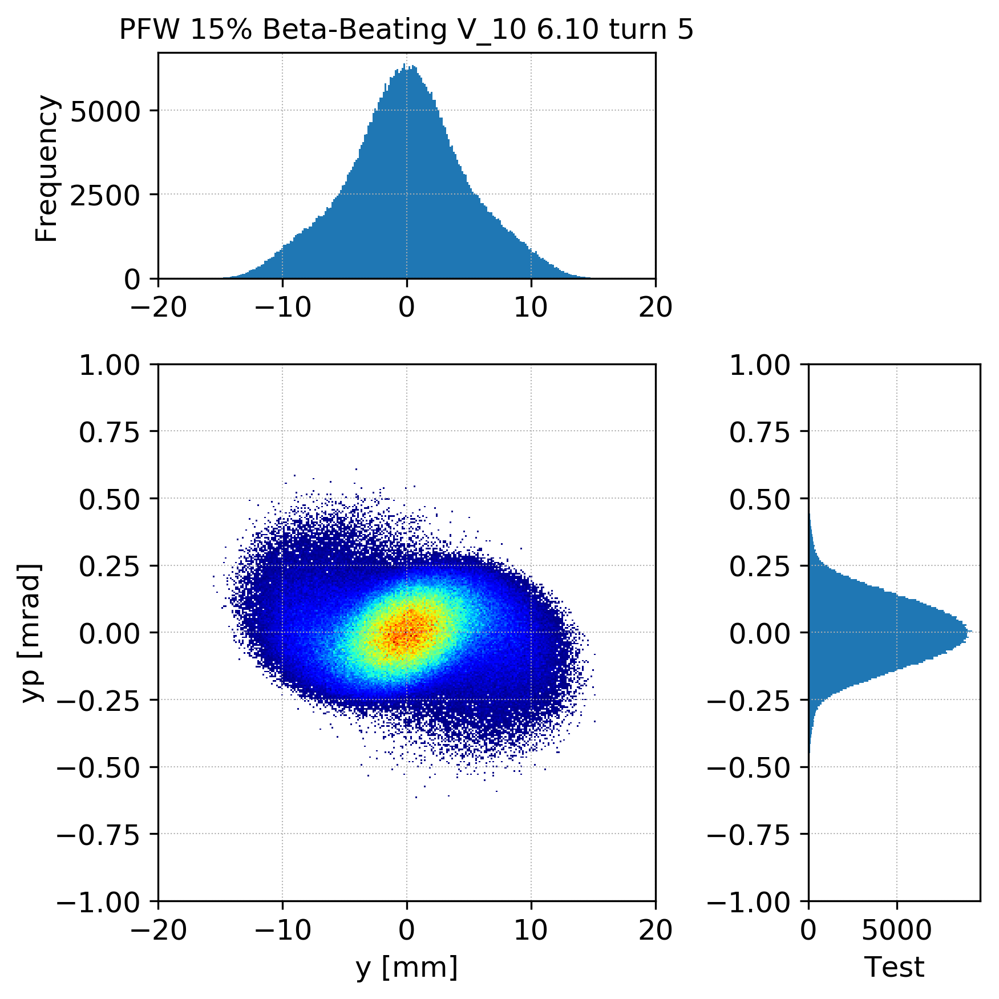

...

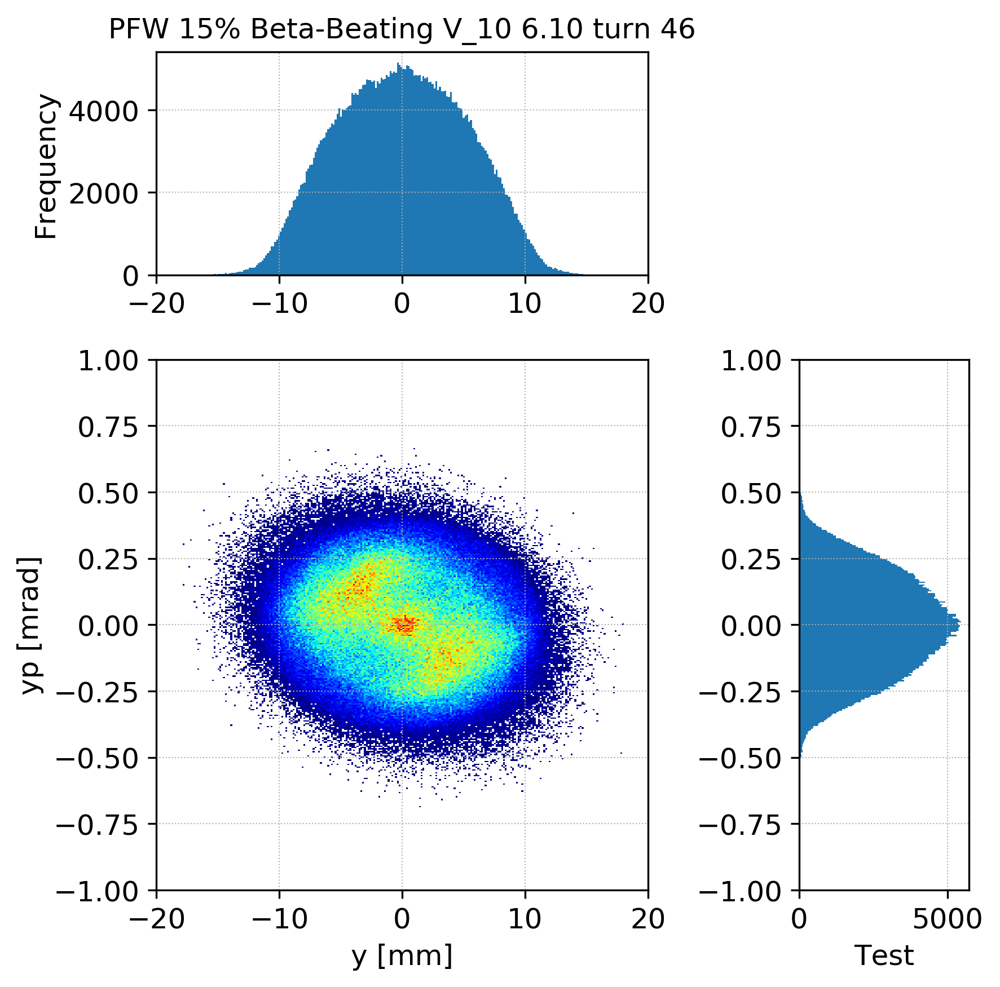

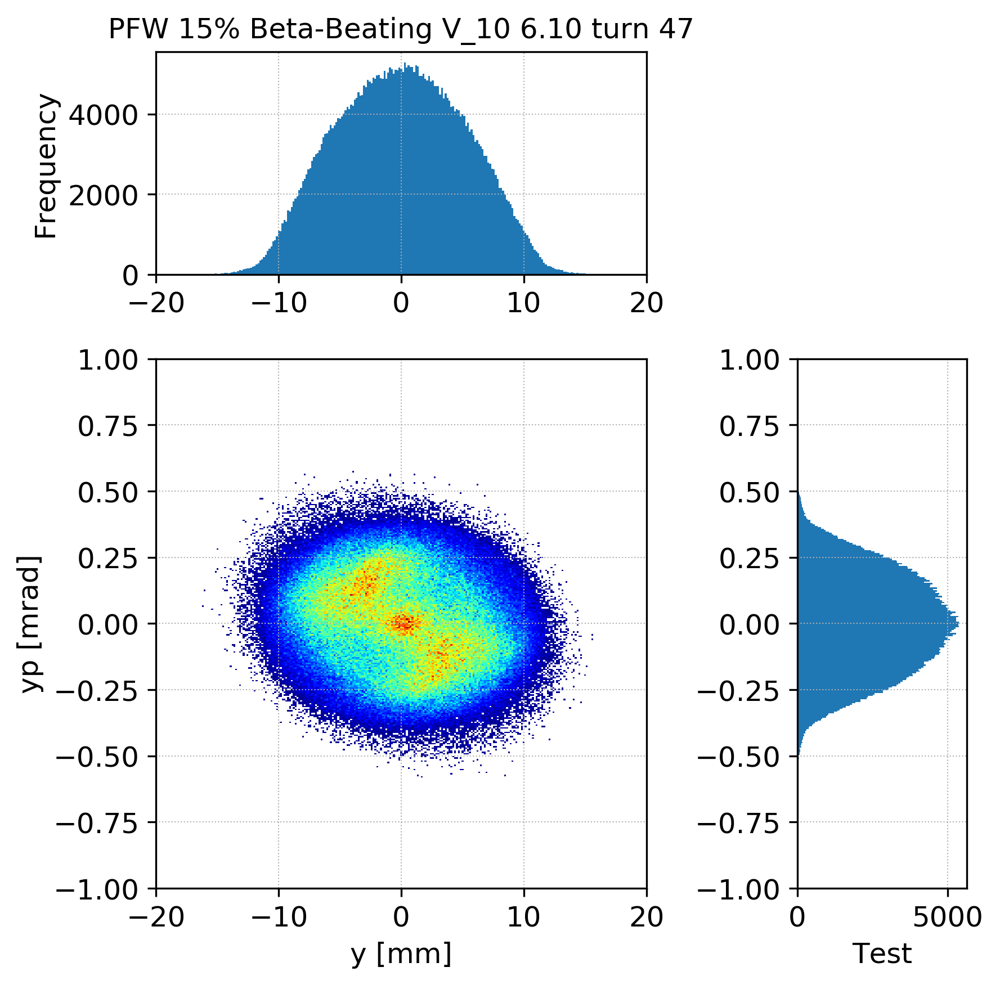

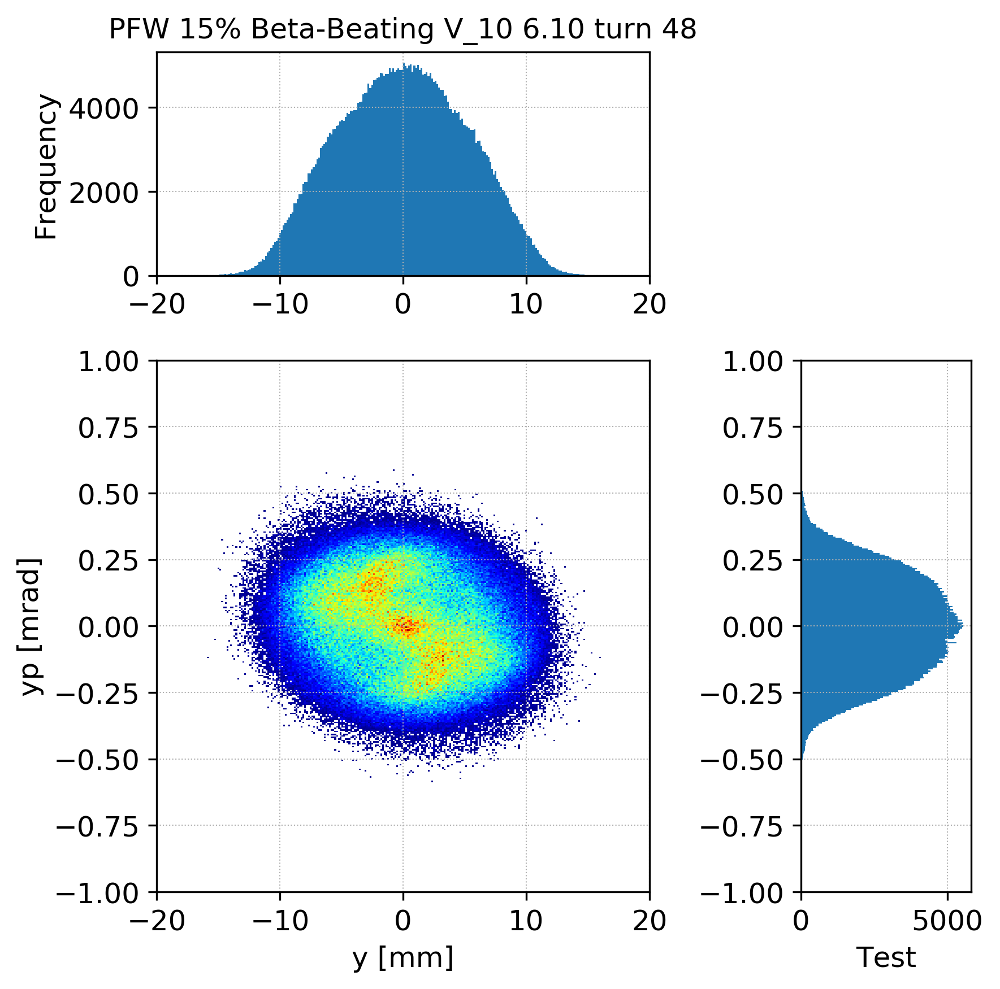

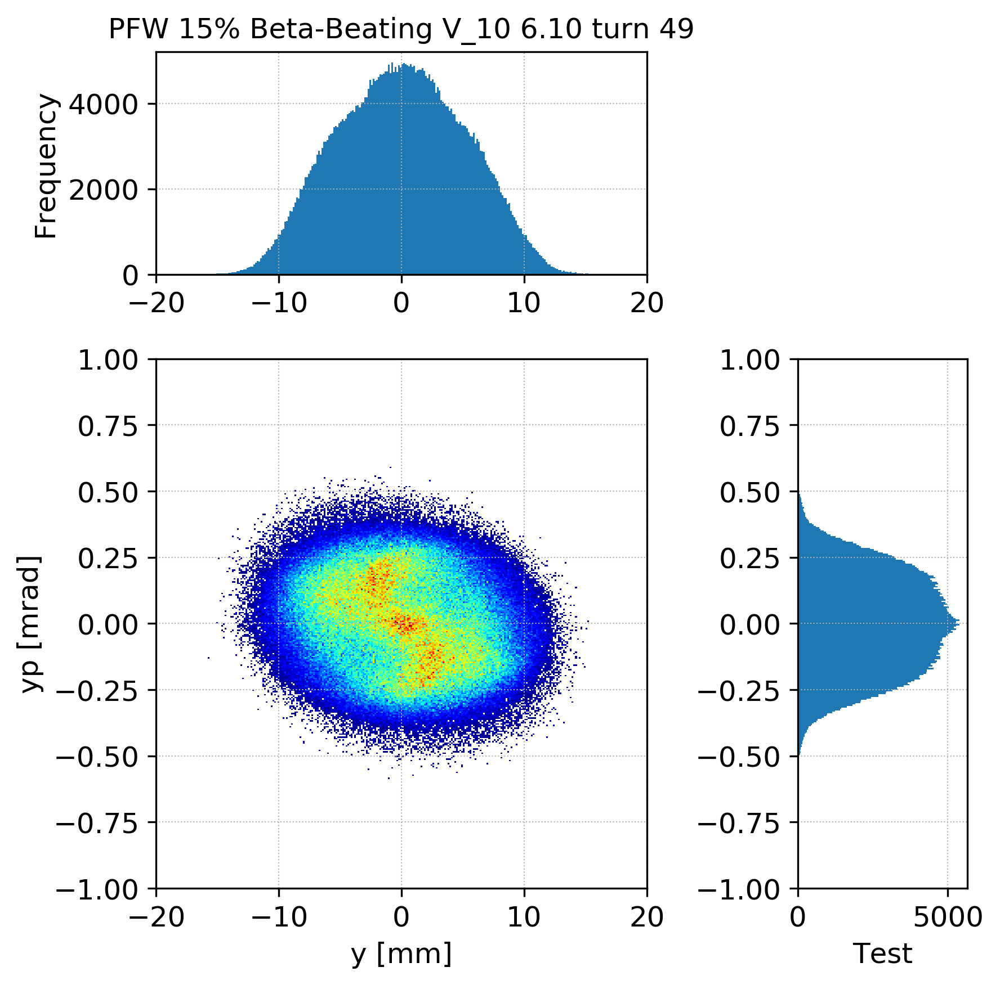

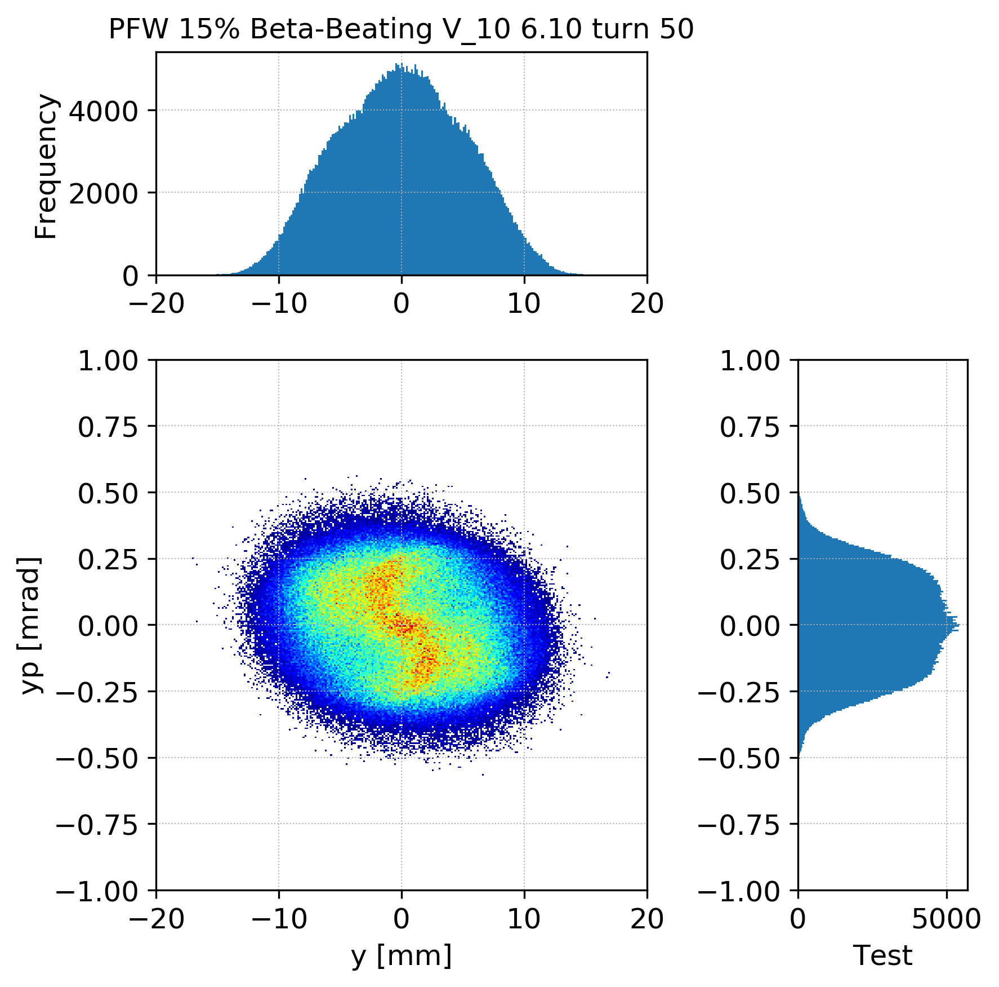

In [12]:
yyp_gifnames =[]

for i, file in enumerate(files):
    bin_size = 256
    
    folder = file.split('/')[0] + '/' + file.split('/')[1]
    case = 'V'
    tune_tit = '6.10'
    tune_sav = '6p10'  
    
    try: 
        turn = int(file.split('mainbunch_')[-1][:-4])
        #turn = '%04d'%turn
    except:
        turn = ''
        
    print '\t Plotting ', case, ' scan tune =', tune_tit, ' turn = ', str(turn), '  real space with histograms'
        
    particles = sio.loadmat(file, squeeze_me=True,  struct_as_record=False)['particles']
    x  = particles.x * 1E3
    xp = particles.xp* 1E3
    y  = particles.y * 1E3
    yp = particles.yp* 1E3
    z  = particles.z * 1E9
    dE = particles.dE
    
    f, ax = plt.subplots(1, figsize=(6,6))
    gridspec.GridSpec(3,3)
    #f.subplots_adjust(hspace = 0)	# Horizontal spacing between subplots
    f.subplots_adjust(wspace = 0)	# Vertical spacing between subplots
    
    
    my_cmap = plt.cm.jet
    my_cmap.set_under('w',1)
        
    title = str( main_label + ' ' + tune_tit + ' turn ' + str(turn)  ) 
    
    # First subplot
 
    plt.subplot2grid((3,3), (0,0), colspan=2, rowspan=1)   
    plt.hist(y, bins=bin_size, range=(np.min(y), np.max(y))) #, norm=mcolors.PowerNorm(gamma))
    plt.title(title, fontsize=fontsize)
    plt.ylabel('Frequency')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.xlim(-20, 20)   
    
    # Main plot
    plt.subplot2grid((3,3), (1,0), colspan=2, rowspan=2)
    plt.hist2d(y, yp, bins=bin_size, cmap=my_cmap, vmin=1, range=[[np.min(y), np.max(y)], [np.min(yp), np.max(yp)]]) #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('y [mm]')
    plt.ylabel('yp [mrad]')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.xlim(-20, 20)
    plt.ylim(-1, 1)
    
    # Second subplot
    plt.subplot2grid((3,3), (1,2), colspan=1, rowspan=2)    
    plt.hist(yp, bins=bin_size, range=(np.min(yp), np.max(yp)), orientation=u'horizontal') #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('Test')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.ylim(-1, 1)
    
    current_axis = plt.gca()
    #current_axis.axes.get_yaxis().set_visible(False)
    
    #ax.xaxis.label.set_size(fontsize)
    #ax.yaxis.label.set_size(fontsize)
    
    #ax.tick_params(labelsize=fontsize)
    
    plt.tight_layout()
    savename = str(folder + '/Y_Phase_Space_' + case + '_' + tune_sav + '_turn_' + str(turn) + '_hist.png' )
    yyp_gifnames.append(savename)
    f.savefig(savename, dpi=500)
    #plt.close(f)

# Longitudinal Phase Space

	 Plotting  V  scan tune = 6.10  turn =  1   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  2   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  3   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  4   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  5   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  6   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  7   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  8   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  9   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  10   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  11   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  12   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  13   real space with histograms
	 Plotting  V  scan tune = 6.10  turn =  14   real space wit

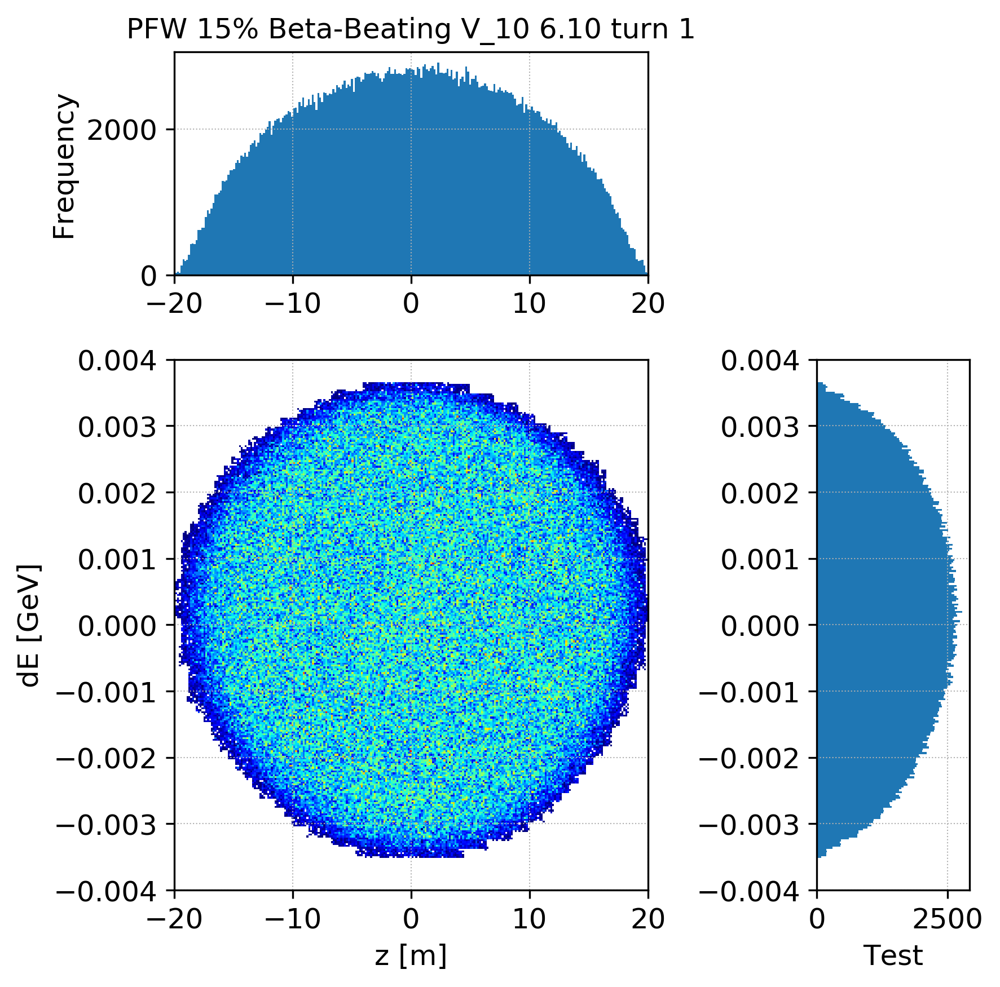

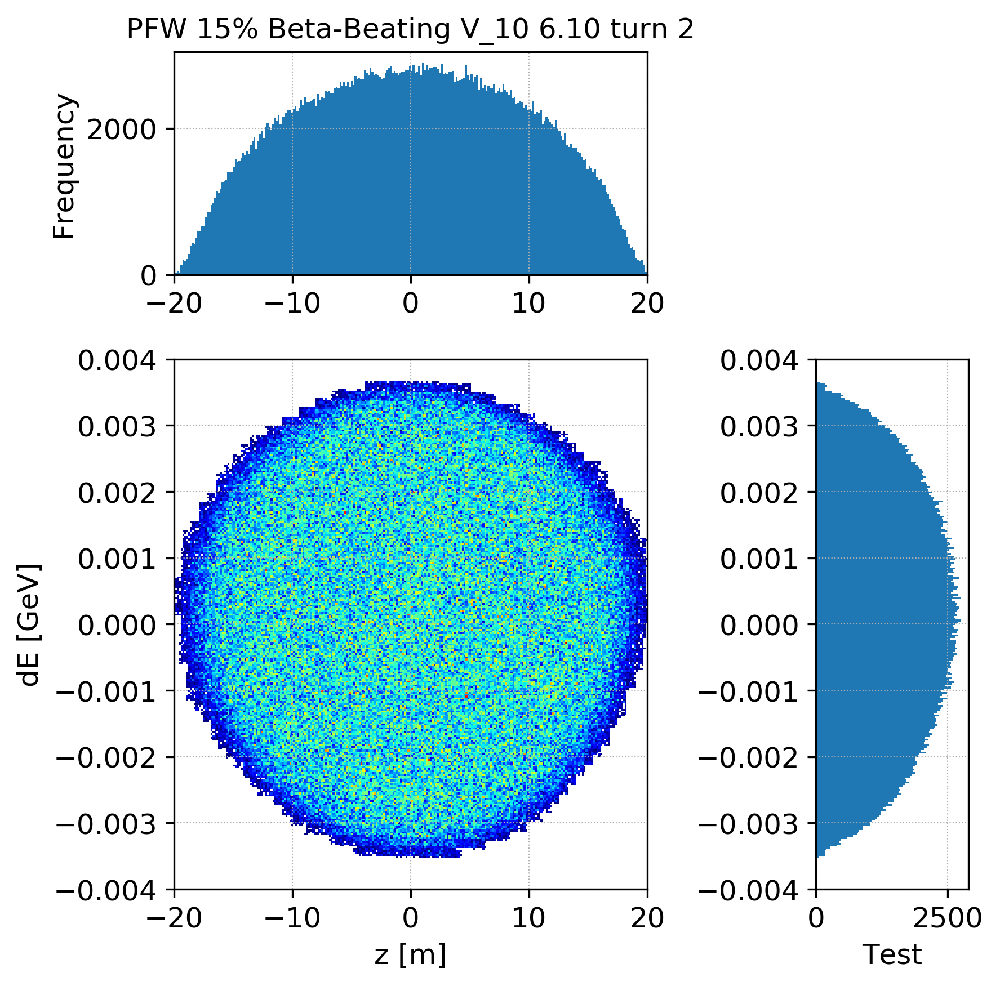

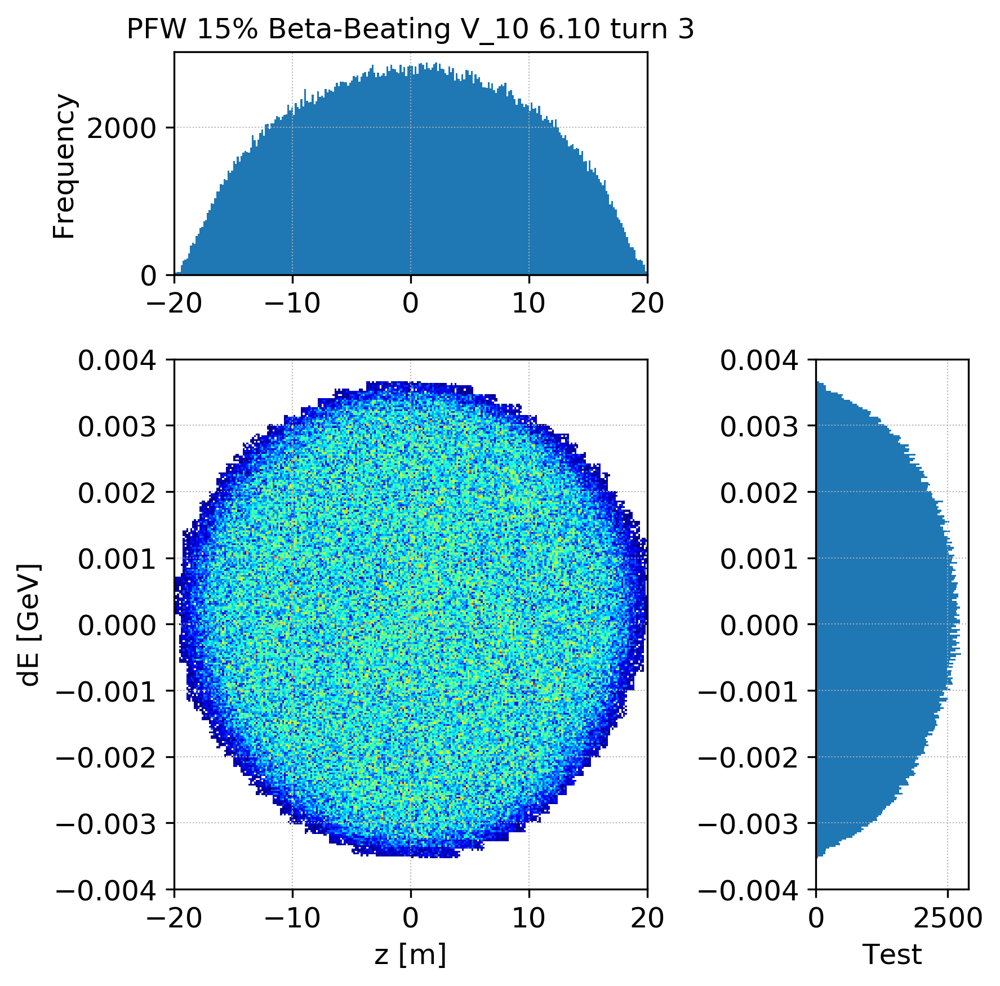

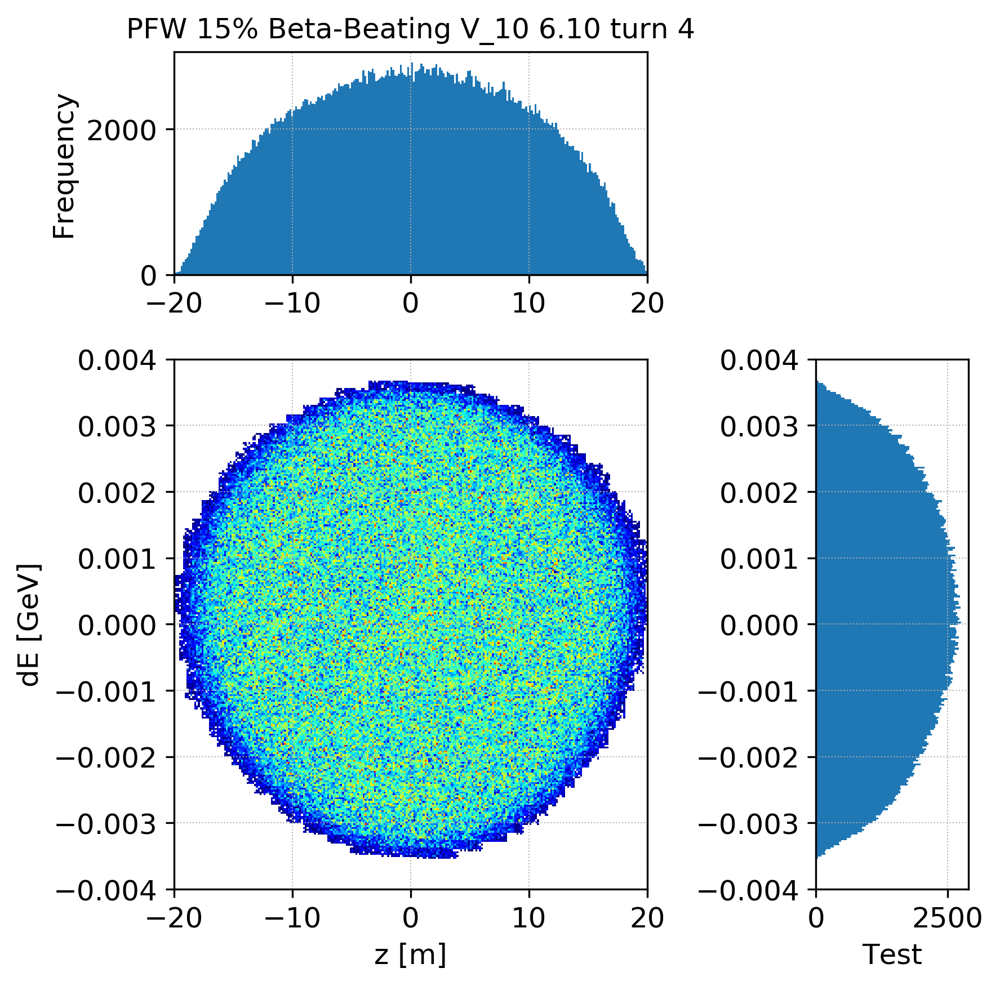

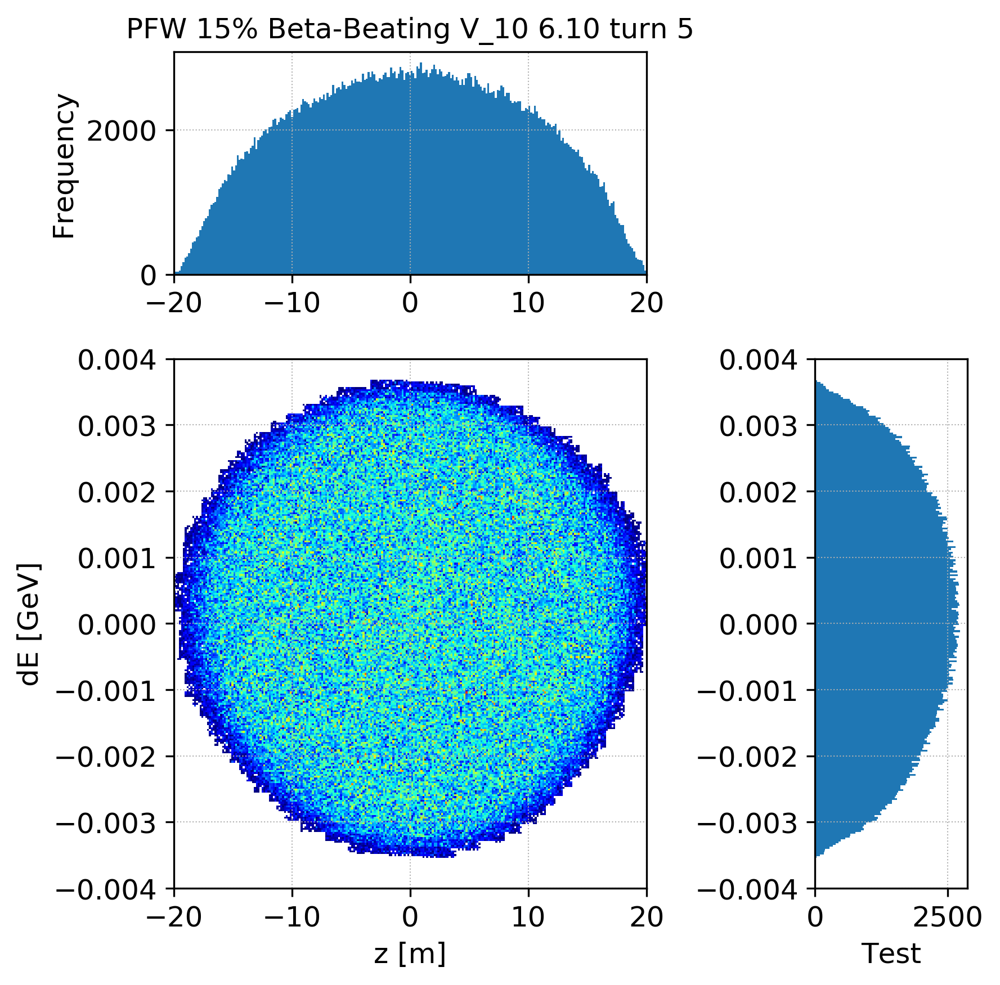

...

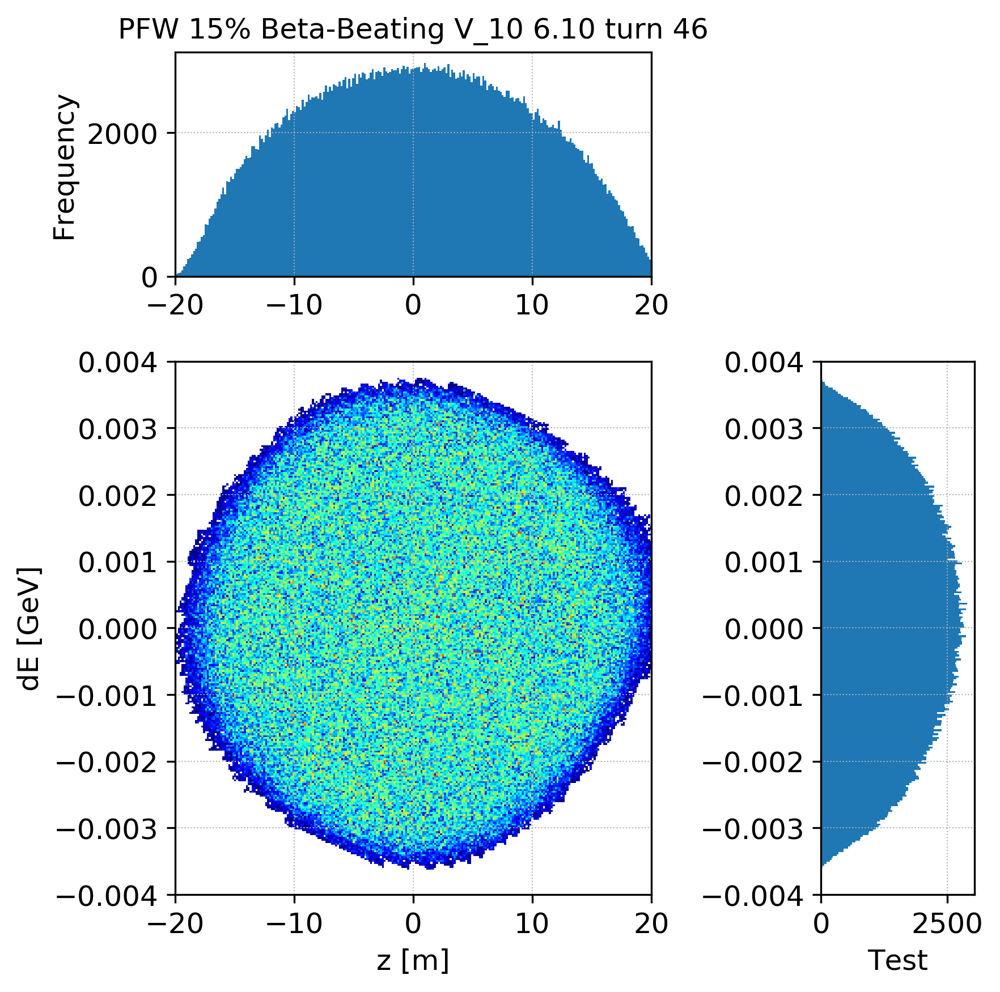

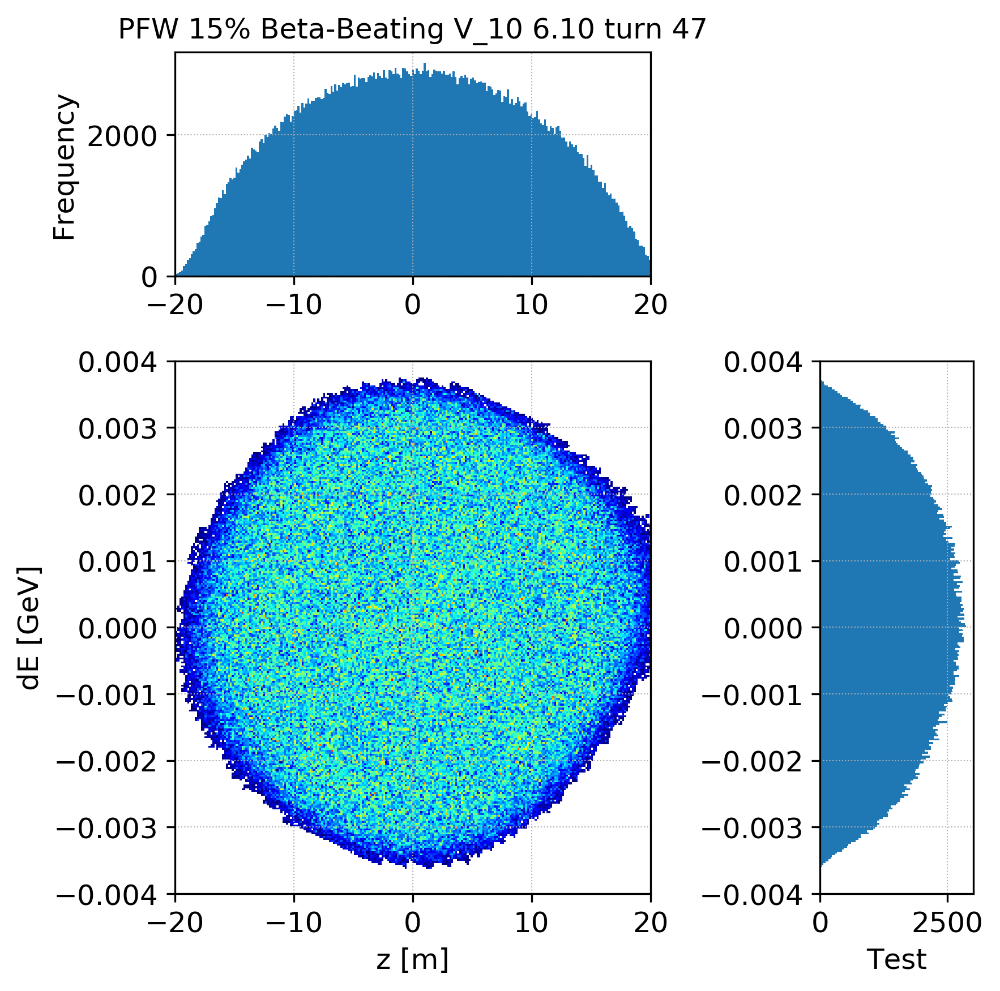

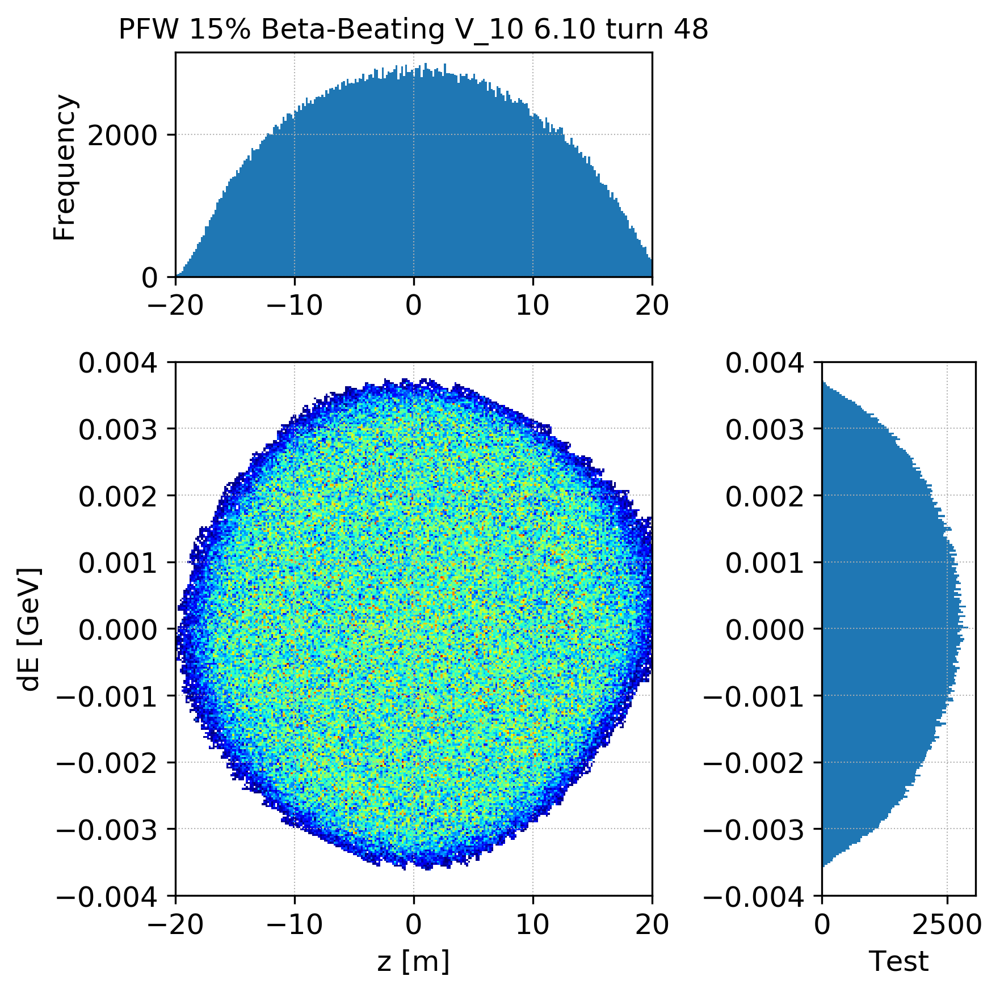

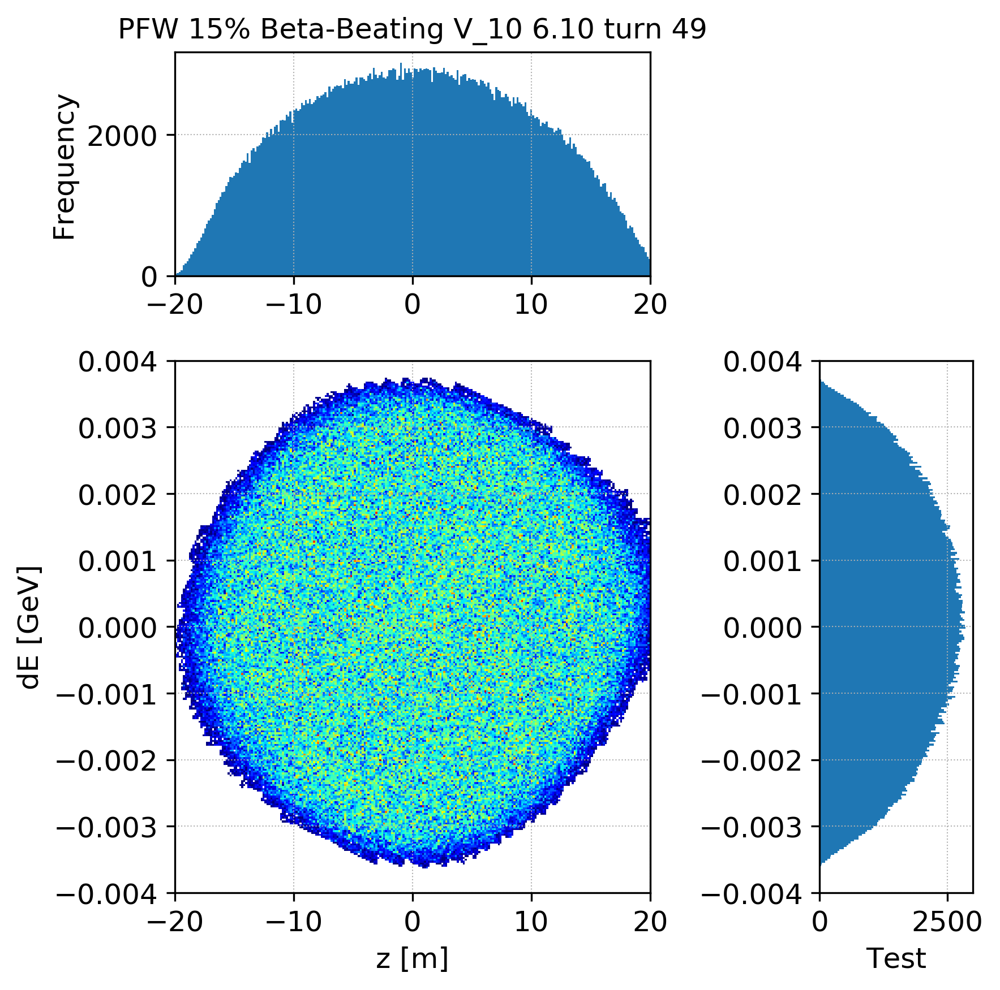

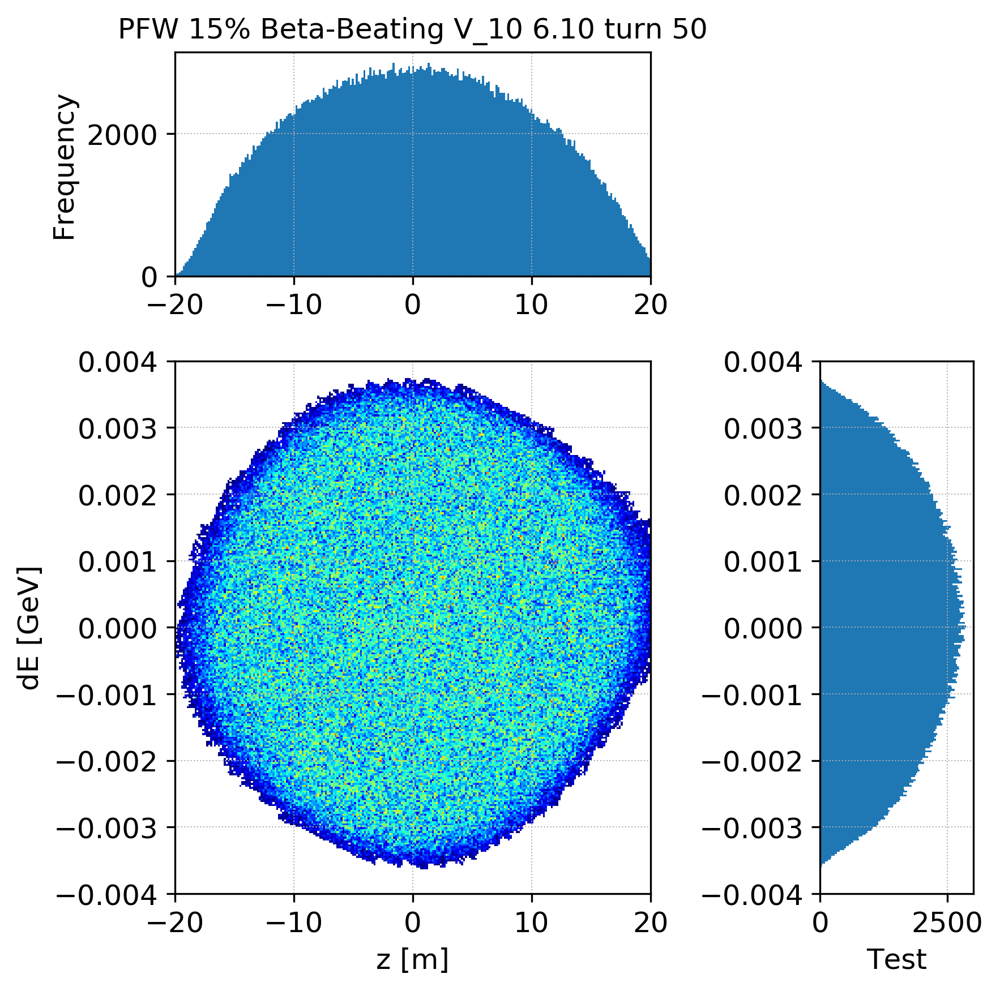

In [13]:
zdE_gifnames =[]

for i, file in enumerate(files):
    bin_size = 256
    
    folder = file.split('/')[0] + '/' + file.split('/')[1]
    case = 'V'
    tune_tit = '6.10'
    tune_sav = '6p10'  
    
    try: 
        turn = int(file.split('mainbunch_')[-1][:-4])
        #turn = '%04d'%turn
    except:
        turn = ''
        
    print '\t Plotting ', case, ' scan tune =', tune_tit, ' turn = ', str(turn), '  real space with histograms'
        
    particles = sio.loadmat(file, squeeze_me=True,  struct_as_record=False)['particles']
    x  = particles.x * 1E3
    xp = particles.xp* 1E3
    y  = particles.y * 1E3
    yp = particles.yp* 1E3
    z  = particles.z
    dE = particles.dE
    
    f, ax = plt.subplots(1, figsize=(6,6))
    gridspec.GridSpec(3,3)
    #f.subplots_adjust(hspace = 0)	# Horizontal spacing between subplots
    f.subplots_adjust(wspace = 0)	# Vertical spacing between subplots
    
    
    my_cmap = plt.cm.jet
    my_cmap.set_under('w',1)
        
    title = str( main_label + ' ' + tune_tit + ' turn ' + str(turn)  ) 
    
    # First subplot
 
    plt.subplot2grid((3,3), (0,0), colspan=2, rowspan=1)   
    plt.hist(z, bins=bin_size, range=(np.min(z), np.max(z))) #, norm=mcolors.PowerNorm(gamma))
    plt.title(title, fontsize=fontsize)
    plt.ylabel('Frequency')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.xlim(-20, 20)   
    
    # Main plot
    plt.subplot2grid((3,3), (1,0), colspan=2, rowspan=2)
    plt.hist2d(z, dE, bins=bin_size, cmap=my_cmap, vmin=1, range=[[np.min(z), np.max(z)], [np.min(dE), np.max(dE)]]) #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('z [m]')
    plt.ylabel('dE [GeV]')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.xlim(-20, 20)
    plt.ylim(-0.004, 0.004)
    
    # Second subplot
    plt.subplot2grid((3,3), (1,2), colspan=1, rowspan=2)    
    plt.hist(dE, bins=bin_size, range=(np.min(dE), np.max(dE)), orientation=u'horizontal') #, norm=mcolors.PowerNorm(gamma))
    plt.xlabel('Test')
    plt.grid(which='both', ls=':', lw=0.5)
    plt.ylim(-0.004, 0.004)
    
    current_axis = plt.gca()
    #current_axis.axes.get_yaxis().set_visible(False)
    
    #ax.xaxis.label.set_size(fontsize)
    #ax.yaxis.label.set_size(fontsize)
    
    #ax.tick_params(labelsize=fontsize)
    
    plt.tight_layout()
    savename = str(folder + '/zdE_Phase_Space_' + case + '_' + tune_sav + '_turn_' + str(turn) + '_hist.png' )
    zdE_gifnames.append(savename)
    f.savefig(savename, dpi=500)
    #plt.close(f)